# Striping sweep diagnostics (PRISMA vs EnMAP)

Column-wise striping scan on homogeneous calibration scenes. Sweeps wavelengths, measures FFT stripe peak strength and column variability, then summarises per sensor. Uses the same PRISMA/EnMAP test scenes as other notebooks.


## What this notebook does
- Compare PRISMA vs EnMAP striping using three complementary metrics: (1) scene-based striping amplitude as % of signal (robust MAD on high-pass residual), (2) adjacent-band ratio amplitude to suppress scene texture, (3) FFT periodicity of the column/row offset vector.
- Sweep overlapping wavelengths with optional methane windows (~1650, ~2300 nm), ROI/edge crop, and both periodic and non-periodic checks.
- Summaries, plots, and worst-band diagnostics (raw, residual, column offsets, FFT) so you can spot instrument-driven striping and scene-agnostic artefacts.


## Metrics guide (tables and plots)
- `band_nm` / `target_nm`: actual band vs requested target.
- **Scene-based amplitude**: `scene_col_amp_pct`, `scene_row_amp_pct` = 100 * 1.4826 * MAD(column/row offsets of high-pass residual) / median(scene). High = stronger striping in that direction.
- **Ratio-based amplitude**: `ratio_col_amp_pct`, `ratio_row_amp_pct` computed on adjacent-band ratios (skips if Δλ > MAX_RATIO_DWL_NM). Suppresses scene structure; high values imply detector pattern rather than surface texture.
- **FFT periodicity**: `fft_col_peak_db`, `fft_col_peak_freq_cyc_per_px`, `fft_col_energy_ratio`, `fft_col_peak_prominence_db` (row equivalents if enabled) from the column-offset vector. High dB/energy_ratio + stable freq = periodic striping.
- **Legacy metrics** (kept for continuity): `legacy_stripe_peak_db`, `legacy_stripe_peak_freq_cyc_per_px`, `legacy_column_std_ratio`, `legacy_global_std`.
- Summary table fields: medians and p90 for scene/ratio amplitudes and FFT metrics per sensor; legacy percentiles follow after.
- Plots: point curves are per-band values; “rolling median” smooths trends. CH4-window plots restrict to methane windows; spans highlight the window.
- Worst-band tables/plots: list top-N bands per metric; show raw and residual images, column offset vectors, and FFT power with the detected peak.


## Theoretical background (striping diagnostics)
- **Source of striping**: Pushbroom imagers use column-aligned detectors. Gain/offset drifts per detector introduce column biases; if they repeat by module/readout, the pattern becomes quasi-periodic.
- **Scene-based amplitude**: Remove scene structure with a low-pass filter, take the residual, then median-compress along columns/rows. A robust MAD (scaled) on that offset vector, normalised by scene median, yields striping amplitude as % of signal.
- **Ratio-based amplitude**: Adjacent-band ratios suppress surface texture; applying the same MAD metric on the ratio residual highlights detector artefacts even in textured scenes. Ratios are skipped when Δλ is large.
- **FFT periodicity**: FFT of the column-offset vector (Hann-windowed, DC suppressed) exposes narrowband periodic striping. Peak dB/energy ratio quantify strength; peak frequency gives the stripe period (cycles/pixel).
- **Assumptions**: (1) stripes are column-oriented; row metrics are optional. (2) scenes are homogeneous so residuals reflect instrument effects. (3) low-signal bands can inflate noise—guarded by valid-fraction and median-signal checks. (4) Edge/ROI cropping keeps optional control.
- **Methane windows**: Around ~1650 nm and ~2300 nm, atmospheric absorption lowers signal, which can exaggerate apparent striping. Focus plots assess whether detector artefacts could bias CH4 retrievals.


## Periodic vs non-periodic striping checks
- **Periodic detection (FFT)**: `fft_col_peak_db`, `fft_col_energy_ratio`, `fft_col_peak_freq_cyc_per_px`, `fft_col_peak_prominence_db` quantify repeating stripe modes from the column-offset vector. High dB/energy + stable frequency → instrument/readout periodicity.
- **Non-periodic detection (offset variance)**: `scene_col_amp_pct`/`scene_row_amp_pct` capture column/row biases on the high-pass residual; `ratio_col_amp_pct` adds a scene-suppressed view via adjacent-band ratios. High % means strong per-detector offsets even without a narrow frequency.
- **How the notebook uses both**: Every band records both families; summaries and plots show them side by side; worst-band tables list scene, ratio, and FFT metrics together.
- **Interpreting combinations**:
  - High FFT + high scene/ratio amplitude → periodic striping tied to detector blocks/readout cadence.
  - Low FFT but high scene/ratio amplitude → non-periodic column bias or calibration drift.
  - High FFT but modest amplitude → narrow periodic stripe on otherwise uniform columns.
  - Both low → negligible striping (or band too low-signal if checks masked values).


## Setup
- Locate repository root and add to `PYTHONPATH`
- Configure plotting defaults


In [12]:
import os
import sys
from pathlib import Path

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

NOTEBOOK_ROOT = Path.cwd().resolve()
REPO_ROOT = NOTEBOOK_ROOT
while not (REPO_ROOT / "scripts").exists() and REPO_ROOT.parent != REPO_ROOT:
    REPO_ROOT = REPO_ROOT.parent
if not (REPO_ROOT / "scripts").exists():
    raise RuntimeError("Could not locate repository root containing scripts directory.")

os.environ.setdefault("PYTHONPATH", str(REPO_ROOT))
if str(REPO_ROOT) not in sys.path:
    sys.path.insert(0, str(REPO_ROOT))

plt.style.use("seaborn-v0_8-colorblind")
pd.set_option("display.max_rows", 20)
pd.set_option("display.max_columns", 20)

print(f"Notebook root: {NOTEBOOK_ROOT}")
print(f"Repository root: {REPO_ROOT}")


Notebook root: /mnt/d/Lavoro/Assegno_Ricerca_Sapienza/CLEAR_UP/CH4_detection/Matched_filter_approach/hygas/notebooks
Repository root: /mnt/d/Lavoro/Assegno_Ricerca_Sapienza/CLEAR_UP/CH4_detection/Matched_filter_approach/hygas


## Configuration
Adjust wavelength sweep density or restrict to a manual list. ROIs stay optional because scenes are homogeneous.


In [13]:
from typing import Dict, List, Optional

STRIPE_TARGET_MODE = "grid"  # "grid" to sweep, "manual" to use MANUAL_TARGETS_NM
GRID_STEP_NM = 10.0           # wavelength spacing for grid mode
MANUAL_TARGETS_NM: List[float] = [1250.0, 1650.0, 2200.0]
MAX_TARGETS: Optional[int] = None  # cap number of targets; None = no cap

EDGE_CROP_COLS = 0            # drop this many columns on each side

HPF_METHOD = "gaussian"    # "gaussian" or "box" for low-pass
GAUSS_SIGMA_PX = 10.0
BOX_KERNEL_PX = 31
MIN_VALID_FRACTION = 0.95      # require this fraction of finite pixels in ROI
MIN_FREQ_CYC_PER_PX = 1.0 / 256.0
PEAK_HALF_WIDTH_BINS = 1
MAX_RATIO_DWL_NM = 20.0        # skip ratio metric if adjacent band spacing exceeds this
COMPUTE_ROW_METRICS = True     # also compute row-wise metrics
NORMALISE_BY = "median"       # keep median normalisation
RATIO_EPS = 1e-6
LOW_STD_EPS = 1e-6

SAVE_FIGURES = False
OUTPUTS_DIR = NOTEBOOK_ROOT / "outputs"
TABLE_DIR = OUTPUTS_DIR
FIG_DIR = OUTPUTS_DIR / "figures"
RUN_CONFIG_PATH = OUTPUTS_DIR / "run_config.json"

SCENE_CONFIG: Dict[str, Dict[str, object]] = {
    "enmap": {
        "name": "enmap",
        "scene_id": "L1B-DT0000001584_20220712T104302Z_001_V010502_20251017T093724Z",
        "data_dir": REPO_ROOT
        / "test_data"
        / "enmap"
        / "Agadez_Niger_20220712"
        / "L1B-DT0000001584_20220712T104302Z_001_V010502_20251017T093724Z",
        "striping_roi": None,  # "x0:x1,y0:y1" (cols,rows) if you want to window
    },
    "prisma": {
        "name": "prisma",
        "scene_id": "20200401085313",
        "l1_path": REPO_ROOT
        / "test_data"
        / "prisma"
        / "Northern_State_Sudan_20200401"
        / "20200401085313_20200401085318"
        / "PRS_L1_STD_OFFL_20200401085313_20200401085318_0001.zip",
        "l2_path": REPO_ROOT
        / "test_data"
        / "prisma"
        / "Northern_State_Sudan_20200401"
        / "20200401085313_20200401085318"
        / "PRS_L2C_STD_20200401085313_20200401085318_0001.zip",
        "striping_roi": None,
    },
}

CH4_WINDOWS = {
    "CH4_1650": (1600.0, 1700.0),
    "CH4_2300": (2200.0, 2350.0),
}  # methane absorption windows (approx)


## Run parameters snapshot
Captured for reproducibility and saved to `run_config.json` alongside outputs.

In [14]:
import json
from datetime import datetime

OUTPUTS_DIR.mkdir(parents=True, exist_ok=True)
FIG_DIR.mkdir(parents=True, exist_ok=True)

run_config = {
    "stripe_target_mode": STRIPE_TARGET_MODE,
    "grid_step_nm": GRID_STEP_NM,
    "manual_targets_nm": MANUAL_TARGETS_NM,
    "max_targets": MAX_TARGETS,
    "edge_crop_cols": EDGE_CROP_COLS,
    "hpf_method": HPF_METHOD,
    "gauss_sigma_px": GAUSS_SIGMA_PX,
    "box_kernel_px": BOX_KERNEL_PX,
    "min_valid_fraction": MIN_VALID_FRACTION,
    "min_freq_cyc_per_px": MIN_FREQ_CYC_PER_PX,
    "peak_half_width_bins": PEAK_HALF_WIDTH_BINS,
    "max_ratio_dwl_nm": MAX_RATIO_DWL_NM,
    "compute_row_metrics": COMPUTE_ROW_METRICS,
    "normalise_by": NORMALISE_BY,
    "ratio_eps": RATIO_EPS,
    "low_std_eps": LOW_STD_EPS,
    "save_figures": SAVE_FIGURES,
    "striping_roi_enmap": SCENE_CONFIG["enmap"].get("striping_roi"),
    "striping_roi_prisma": SCENE_CONFIG["prisma"].get("striping_roi"),
    "ch4_windows": CH4_WINDOWS,
    "timestamp_utc": datetime.utcnow().isoformat() + "Z",
}

print("Run configuration:")
for k, v in run_config.items():
    print(f"  {k}: {v}")

with open(RUN_CONFIG_PATH, "w") as f:
    json.dump(run_config, f, indent=2, sort_keys=True)
print(f"Saved run config to {RUN_CONFIG_PATH}")


Run configuration:
  stripe_target_mode: grid
  grid_step_nm: 10.0
  manual_targets_nm: [1250.0, 1650.0, 2200.0]
  max_targets: None
  edge_crop_cols: 0
  hpf_method: gaussian
  gauss_sigma_px: 10.0
  box_kernel_px: 31
  min_valid_fraction: 0.95
  min_freq_cyc_per_px: 0.00390625
  peak_half_width_bins: 1
  max_ratio_dwl_nm: 20.0
  compute_row_metrics: True
  normalise_by: median
  ratio_eps: 1e-06
  low_std_eps: 1e-06
  save_figures: False
  striping_roi_enmap: None
  striping_roi_prisma: None
  ch4_windows: {'CH4_1650': (1600.0, 1700.0), 'CH4_2300': (2200.0, 2350.0)}
  timestamp_utc: 2025-12-21T16:18:11.018927Z
Saved run config to /mnt/d/Lavoro/Assegno_Ricerca_Sapienza/CLEAR_UP/CH4_detection/Matched_filter_approach/hygas/notebooks/outputs/run_config.json


## Helpers
Scene loading and basic utilities reused from earlier notebooks.


In [15]:
from functools import lru_cache
from typing import Any, Mapping, Sequence, Tuple

import numpy as np

from scripts.diagnostics import striping

try:
    from scipy.ndimage import gaussian_filter, uniform_filter
except Exception:
    gaussian_filter = None
    uniform_filter = None

EPS = 1e-9


def parse_roi(spec: Optional[str], rows: int, cols: int) -> Optional[Tuple[slice, slice]]:
    if spec is None:
        return None
    try:
        x_part, y_part = spec.split(",")
        x0, x1 = [int(v) for v in x_part.split(":")]
        y0, y1 = [int(v) for v in y_part.split(":")]
    except Exception as exc:
        raise ValueError("ROI must follow 'x0:x1,y0:y1' (cols,rows)") from exc
    if not (0 <= x0 < x1 <= cols and 0 <= y0 < y1 <= rows):
        raise ValueError(f"ROI {spec} outside bounds (rows={rows}, cols={cols})")
    return slice(y0, y1), slice(x0, x1)


def apply_roi_and_crop(img: np.ndarray, roi_spec: Optional[str], edge_crop_cols: int = 0) -> np.ndarray:
    arr = img.astype(float)
    rows, cols = arr.shape
    if roi_spec:
        roi = parse_roi(roi_spec, rows, cols)
        arr = arr[roi[0], roi[1]]
        rows, cols = arr.shape
    if edge_crop_cols > 0 and edge_crop_cols * 2 < cols:
        arr = arr[:, edge_crop_cols:-edge_crop_cols]
    return arr


def ensure_directory(path: Path) -> Path:
    path = Path(path)
    if not path.exists():
        raise FileNotFoundError(path)
    return path


def _resolve_prisma_he5(path: Path) -> Path:
    path = Path(path).expanduser().resolve()
    if not path.exists():
        raise FileNotFoundError(path)
    if path.suffix.lower() == ".zip":
        from scripts.satellites import prisma_utils

        extracted = prisma_utils.extract_he5_from_zip(str(path), str(path.parent))
        if extracted is None:
            raise FileNotFoundError(f"No .he5 found inside {path}")
        return Path(extracted).resolve()
    return path


def _load_prisma(cfg: Mapping[str, object]) -> Dict[str, Any]:
    from scripts.satellites import prisma_utils

    he5_path = _resolve_prisma_he5(Path(cfg["l1_path"]))
    cube, cw_matrix, fwhm_matrix, *_ = prisma_utils.prisma_read(str(he5_path))
    cube_brc = np.transpose(cube, (2, 0, 1)).astype(np.float32)
    cw_matrix = np.asarray(cw_matrix, dtype=np.float64)
    wavelengths = np.nanmean(cw_matrix, axis=0)
    return {
        "cube_brc": cube_brc,
        "cw_matrix": cw_matrix,
        "fwhm_matrix": np.asarray(fwhm_matrix, dtype=np.float64),
        "wavelengths": wavelengths,
        "he5_path": he5_path,
    }


def _load_enmap(cfg: Mapping[str, object]) -> Dict[str, Any]:
    from scripts.satellites import enmap_utils

    data_dir = ensure_directory(Path(cfg["data_dir"]).expanduser())
    vnir_path, swir_path, xml_path = enmap_utils.find_enmap_files(str(data_dir))
    cube, cw_vec, fwhm_vec, *_ = enmap_utils.enmap_read(vnir_path, swir_path, xml_path)
    cube_brc = np.transpose(cube, (2, 0, 1)).astype(np.float32)
    vnir_meta, swir_meta = enmap_utils.parse_metadata_vnir_swir(xml_path)
    return {
        "cube_brc": cube_brc,
        "wavelengths": np.asarray(cw_vec, dtype=np.float64),
        "fwhm": np.asarray(fwhm_vec, dtype=np.float64),
        "vnir_meta": vnir_meta,
        "swir_meta": swir_meta,
        "xml_path": Path(xml_path),
    }


SCENE_DATA_CACHE: Dict[str, Dict[str, Any]] = {}


@lru_cache(maxsize=4)
def load_scene(sensor: str) -> Dict[str, Any]:
    sensor = sensor.lower()
    if sensor in SCENE_DATA_CACHE:
        return SCENE_DATA_CACHE[sensor]
    cfg = SCENE_CONFIG[sensor]
    if sensor == "prisma":
        data = _load_prisma(cfg)
    elif sensor == "enmap":
        data = _load_enmap(cfg)
    else:
        raise KeyError(sensor)
    SCENE_DATA_CACHE[sensor] = data
    return data


def nanmad(v: np.ndarray) -> float:
    med = np.nanmedian(v)
    return float(np.nanmedian(np.abs(v - med)))


def lowpass(img: np.ndarray, method: str = HPF_METHOD, sigma_px: float = GAUSS_SIGMA_PX, box_kernel_px: int = BOX_KERNEL_PX) -> np.ndarray:
    arr = np.asarray(img, dtype=float)
    mask = np.isfinite(arr)
    if not mask.any():
        return np.full_like(arr, np.nan, dtype=float)
    arr0 = np.where(mask, arr, 0.0)

    if method == "gaussian" and gaussian_filter is not None:
        val = gaussian_filter(arr0, sigma=sigma_px, mode="nearest")
        weight = gaussian_filter(mask.astype(float), sigma=sigma_px, mode="nearest")
    else:
        k = int(max(1, box_kernel_px))
        if k % 2 == 0:
            k += 1
        if uniform_filter is not None:
            val = uniform_filter(arr0, size=k, mode="nearest") * (k**2)
            weight = uniform_filter(mask.astype(float), size=k, mode="nearest") * (k**2)
        else:
            pad = k // 2
            arr_pad = np.pad(arr0, pad_width=pad, mode="constant", constant_values=0.0)
            mask_pad = np.pad(mask.astype(float), pad_width=pad, mode="constant", constant_values=0.0)
            csum = arr_pad.cumsum(axis=0).cumsum(axis=1)
            ccount = mask_pad.cumsum(axis=0).cumsum(axis=1)
            val = csum[k:, k:] - csum[:-k, k:] - csum[k:, :-k] + csum[:-k, :-k]
            weight = ccount[k:, k:] - ccount[:-k, k:] - ccount[k:, :-k] + ccount[:-k, :-k]
    lpf = np.where(weight > 0, val / np.clip(weight, EPS, None), np.nan)
    return lpf


def highpass(img: np.ndarray, **kwargs) -> np.ndarray:
    lpf = lowpass(img, **kwargs)
    return img - lpf


def robust_striping_amplitude(
    img: np.ndarray,
    axis: str = "col",
    normalise_by: str = NORMALISE_BY,
    return_vector: bool = False,
    return_residual: bool = False,
    **lpf_kwargs,
) -> Dict[str, Any]:
    resid = highpass(img, **lpf_kwargs)
    if axis == "col":
        m_vec = np.nanmedian(resid, axis=0)
    elif axis == "row":
        m_vec = np.nanmedian(resid, axis=1)
    else:
        raise ValueError("axis must be 'col' or 'row'")
    mad = nanmad(m_vec)
    if normalise_by == "median":
        denom = np.nanmedian(img)
    else:
        denom = np.nanmean(img)
    if not np.isfinite(denom) or abs(denom) < EPS:
        amp_pct = np.nan
    else:
        amp_pct = 100.0 * 1.4826 * mad / denom
    out = {"amp_pct": float(amp_pct)}
    if return_vector:
        out["m_vector"] = m_vec
    if return_residual:
        out["residual"] = resid
    return out


def fft_periodic_metrics(vec: np.ndarray, min_freq: float = MIN_FREQ_CYC_PER_PX, half_width_bins: int = PEAK_HALF_WIDTH_BINS, prominence_window: int = 3) -> Dict[str, float]:
    v = np.asarray(vec, dtype=float)
    mask = np.isfinite(v)
    if v.size < 2 or not mask.any():
        return {"peak_db": np.nan, "peak_freq": np.nan, "energy_ratio": np.nan, "prominence_db": np.nan}
    fill_value = float(np.nanmedian(v)) if mask.any() else 0.0
    v_filled = np.where(mask, v, fill_value)
    v_centered = v_filled - np.nanmedian(v_filled)
    window = np.hanning(v_centered.size)
    fft_vals = np.fft.rfft(v_centered * window)
    power = np.abs(fft_vals) ** 2
    freqs = np.fft.rfftfreq(v_centered.size, d=1.0)
    valid = freqs >= max(min_freq, 0.0)
    if valid.size > 0:
        valid[0] = False
    if not valid.any():
        return {"peak_db": np.nan, "peak_freq": np.nan, "energy_ratio": np.nan, "prominence_db": np.nan}
    power_valid = power[valid]
    freqs_valid = freqs[valid]
    if power_valid.size == 0:
        return {"peak_db": np.nan, "peak_freq": np.nan, "energy_ratio": np.nan, "prominence_db": np.nan}
    baseline = np.nanmedian(power_valid) + EPS
    peak_idx_valid = int(np.nanargmax(power_valid))
    peak_power = float(power_valid[peak_idx_valid])
    peak_freq = float(freqs_valid[peak_idx_valid])
    peak_db = 10.0 * np.log10(peak_power / baseline) if peak_power > 0 else np.nan

    idx_full = np.nonzero(valid)[0][peak_idx_valid]
    lo = max(idx_full - half_width_bins, 0)
    hi = min(idx_full + half_width_bins + 1, power.size)
    energy_ratio = float(np.nansum(power[lo:hi]) / np.clip(np.nansum(power[valid]), EPS, None))

    prominence_db = np.nan
    if prominence_window > 0:
        excl = np.ones_like(power, dtype=bool)
        excl[lo:hi] = False
        local = power[valid & excl]
        if local.size:
            local_baseline = np.nanmedian(local) + EPS
            prominence_db = 10.0 * np.log10(peak_power / local_baseline) if peak_power > 0 else np.nan

    return {
        "peak_db": peak_db,
        "peak_freq": peak_freq,
        "energy_ratio": energy_ratio,
        "prominence_db": prominence_db,
    }


def adjacent_ratio(img_num: np.ndarray, img_den: np.ndarray, eps: float = RATIO_EPS) -> np.ndarray:
    num = np.asarray(img_num, dtype=float)
    den = np.asarray(img_den, dtype=float)
    return np.divide(num, den + eps, out=np.full_like(num, np.nan, dtype=float), where=np.isfinite(num) & np.isfinite(den))


## Target selection and per-band striping metrics
Sweeps wavelengths (grid or manual) and measures stripe peak strength with an extra local-prominence check.


In [16]:
from typing import Iterable


def build_targets(
    wavelengths: Sequence[float],
    mode: str = "grid",
    step_nm: float = GRID_STEP_NM,
    manual_targets: Optional[Iterable[float]] = None,
    wl_min: Optional[float] = None,
    wl_max: Optional[float] = None,
    max_targets: Optional[int] = None,
) -> List[float]:
    arr = np.asarray(wavelengths, dtype=float)
    wl_min = float(np.nanmin(arr)) if wl_min is None else wl_min
    wl_max = float(np.nanmax(arr)) if wl_max is None else wl_max
    if mode == "manual":
        targets = list(manual_targets or [])
    else:
        start = np.ceil(wl_min / step_nm) * step_nm
        targets = list(np.arange(start, wl_max + step_nm * 0.5, step_nm))
    targets = [float(t) for t in targets if wl_min <= t <= wl_max]
    uniq: List[float] = []
    for t in targets:
        if not any(abs(u - t) < 1e-3 for u in uniq):
            uniq.append(t)
    if max_targets is not None:
        uniq = uniq[:max_targets]
    return uniq


def nearest_band_index(wavelengths: Sequence[float], target_nm: float) -> Tuple[int, float]:
    arr = np.asarray(wavelengths, dtype=float)
    if arr.size == 0:
        raise ValueError("Empty wavelength array")
    idx = int(np.nanargmin(np.abs(arr - target_nm)))
    return idx, float(arr[idx])


def select_ratio_band(wavelengths: Sequence[float], idx: int, max_ratio_dwl_nm: float) -> Optional[int]:
    wl = np.asarray(wavelengths, dtype=float)
    if idx + 1 < wl.size and abs(wl[idx + 1] - wl[idx]) <= max_ratio_dwl_nm:
        return idx + 1
    if idx - 1 >= 0 and abs(wl[idx] - wl[idx - 1]) <= max_ratio_dwl_nm:
        return idx - 1
    return None


def compute_band_metrics(
    scene: Dict[str, Any],
    target_nm: float,
    roi_spec: Optional[str] = None,
) -> Dict[str, float]:
    cube = scene["cube_brc"]
    wavelengths = scene["wavelengths"]
    idx, band_nm = nearest_band_index(wavelengths, target_nm)
    img = cube[idx].astype(float)
    img = apply_roi_and_crop(img, roi_spec, EDGE_CROP_COLS)
    valid_mask = np.isfinite(img)
    valid_fraction = float(np.mean(valid_mask)) if valid_mask.size else 0.0

    metrics: Dict[str, float] = {
        "band_index": idx + 1,
        "band_nm": float(band_nm),
        "target_nm": float(target_nm),
        "valid_fraction": valid_fraction,
    }

    if not valid_mask.any() or valid_fraction < MIN_VALID_FRACTION:
        # populate NaNs and bail early
        metrics.update({
            "scene_col_amp_pct": np.nan,
            "scene_row_amp_pct": np.nan,
            "ratio_col_amp_pct": np.nan,
            "ratio_row_amp_pct": np.nan,
            "fft_col_peak_db": np.nan,
            "fft_col_peak_freq_cyc_per_px": np.nan,
            "fft_col_energy_ratio": np.nan,
            "fft_col_peak_prominence_db": np.nan,
            "fft_row_peak_db": np.nan,
            "fft_row_peak_freq_cyc_per_px": np.nan,
            "fft_row_energy_ratio": np.nan,
            "fft_row_peak_prominence_db": np.nan,
            "ratio_used_idx": np.nan,
            "legacy_stripe_peak_db": np.nan,
            "legacy_stripe_peak_freq_cyc_per_px": np.nan,
            "legacy_column_std_ratio": np.nan,
            "legacy_global_std": np.nan,
        })
        return metrics

    median_signal = float(np.nanmedian(img))
    if abs(median_signal) < LOW_STD_EPS:
        metrics.update({
            "scene_col_amp_pct": np.nan,
            "scene_row_amp_pct": np.nan,
            "ratio_col_amp_pct": np.nan,
            "ratio_row_amp_pct": np.nan,
            "fft_col_peak_db": np.nan,
            "fft_col_peak_freq_cyc_per_px": np.nan,
            "fft_col_energy_ratio": np.nan,
            "fft_col_peak_prominence_db": np.nan,
            "fft_row_peak_db": np.nan,
            "fft_row_peak_freq_cyc_per_px": np.nan,
            "fft_row_energy_ratio": np.nan,
            "fft_row_peak_prominence_db": np.nan,
            "ratio_used_idx": np.nan,
            "legacy_stripe_peak_db": np.nan,
            "legacy_stripe_peak_freq_cyc_per_px": np.nan,
            "legacy_column_std_ratio": np.nan,
            "legacy_global_std": np.nan,
        })
        return metrics

    # Scene-based amplitude and FFT (columns / rows)
    amp_col = robust_striping_amplitude(
        img,
        axis="col",
        normalise_by=NORMALISE_BY,
        return_vector=True,
        return_residual=True,
    )
    metrics["scene_col_amp_pct"] = float(amp_col["amp_pct"])
    m_col = amp_col.get("m_vector")

    fft_col = fft_periodic_metrics(m_col, min_freq=MIN_FREQ_CYC_PER_PX, half_width_bins=PEAK_HALF_WIDTH_BINS)
    metrics["fft_col_peak_db"] = float(fft_col.get("peak_db"))
    metrics["fft_col_peak_freq_cyc_per_px"] = float(fft_col.get("peak_freq"))
    metrics["fft_col_energy_ratio"] = float(fft_col.get("energy_ratio"))
    metrics["fft_col_peak_prominence_db"] = float(fft_col.get("prominence_db"))

    if COMPUTE_ROW_METRICS:
        amp_row = robust_striping_amplitude(
            img, axis="row", normalise_by=NORMALISE_BY, return_vector=True, return_residual=False
        )
        metrics["scene_row_amp_pct"] = float(amp_row["amp_pct"])
        m_row = amp_row.get("m_vector")
        fft_row = fft_periodic_metrics(m_row, min_freq=MIN_FREQ_CYC_PER_PX, half_width_bins=PEAK_HALF_WIDTH_BINS)
        metrics["fft_row_peak_db"] = float(fft_row.get("peak_db"))
        metrics["fft_row_peak_freq_cyc_per_px"] = float(fft_row.get("peak_freq"))
        metrics["fft_row_energy_ratio"] = float(fft_row.get("energy_ratio"))
        metrics["fft_row_peak_prominence_db"] = float(fft_row.get("prominence_db"))
    else:
        metrics["scene_row_amp_pct"] = np.nan
        metrics["fft_row_peak_db"] = np.nan
        metrics["fft_row_peak_freq_cyc_per_px"] = np.nan
        metrics["fft_row_energy_ratio"] = np.nan
        metrics["fft_row_peak_prominence_db"] = np.nan

    # Ratio-based amplitude
    ratio_idx = select_ratio_band(wavelengths, idx, MAX_RATIO_DWL_NM)
    metrics["ratio_used_idx"] = float(ratio_idx + 1) if ratio_idx is not None else np.nan
    if ratio_idx is not None:
        img_ratio = cube[ratio_idx].astype(float)
        img_ratio = apply_roi_and_crop(img_ratio, roi_spec, EDGE_CROP_COLS)
        ratio_img = adjacent_ratio(img_ratio, img, eps=RATIO_EPS)
        if np.isfinite(ratio_img).mean() >= MIN_VALID_FRACTION:
            ratio_col = robust_striping_amplitude(
                ratio_img, axis="col", normalise_by=NORMALISE_BY, return_vector=False, return_residual=False
            )
            metrics["ratio_col_amp_pct"] = float(ratio_col["amp_pct"])
            if COMPUTE_ROW_METRICS:
                ratio_row = robust_striping_amplitude(
                    ratio_img, axis="row", normalise_by=NORMALISE_BY, return_vector=False, return_residual=False
                )
                metrics["ratio_row_amp_pct"] = float(ratio_row["amp_pct"])
            else:
                metrics["ratio_row_amp_pct"] = np.nan
        else:
            metrics["ratio_col_amp_pct"] = np.nan
            metrics["ratio_row_amp_pct"] = np.nan
    else:
        metrics["ratio_col_amp_pct"] = np.nan
        metrics["ratio_row_amp_pct"] = np.nan

    # Legacy metrics (for continuity)
    legacy_fft = striping.detect_stripe_frequency(img)
    column_std = np.nanstd(img, axis=0)
    metrics["legacy_stripe_peak_db"] = float(legacy_fft.get("peak_db") or np.nan)
    metrics["legacy_stripe_peak_freq_cyc_per_px"] = float(legacy_fft.get("peak_freq") or np.nan)
    metrics["legacy_column_std_ratio"] = float(
        np.nanpercentile(column_std, 95) / np.clip(np.nanmedian(column_std), EPS, None)
    )
    metrics["legacy_global_std"] = float(np.nanstd(img))

    return metrics


## Run sweep
Build the overlap wavelength grid, compute scene/ratio/FFT striping metrics per band for both sensors, and assemble `striping_df`.

In [17]:
prisma_scene = load_scene("prisma")
enmap_scene = load_scene("enmap")

wl_min = max(np.nanmin(prisma_scene["wavelengths"]), np.nanmin(enmap_scene["wavelengths"]))
wl_max = min(np.nanmax(prisma_scene["wavelengths"]), np.nanmax(enmap_scene["wavelengths"]))

if STRIPE_TARGET_MODE == "manual":
    target_nms = [t for t in MANUAL_TARGETS_NM if wl_min <= t <= wl_max]
else:
    target_nms = build_targets(
        wavelengths=[wl_min, wl_max],
        mode="grid",
        step_nm=GRID_STEP_NM,
        wl_min=wl_min,
        wl_max=wl_max,
        max_targets=MAX_TARGETS,
    )

records = []
for sensor_name, scene in (("prisma", prisma_scene), ("enmap", enmap_scene)):
    roi_spec = SCENE_CONFIG[sensor_name].get("striping_roi")
    for target_nm in target_nms:
        try:
            metrics = compute_band_metrics(scene, target_nm, roi_spec=roi_spec)
        except ValueError:
            continue
        metrics["sensor"] = sensor_name.upper()
        records.append(metrics)

striping_df = pd.DataFrame(records).sort_values(["sensor", "band_nm"]).reset_index(drop=True)
print(f"Computed striping metrics for {striping_df.shape[0]} bands across {len(target_nms)} targets.")
striping_df.head()


Computed striping metrics for 406 bands across 203 targets.


,band_index,band_nm,target_nm,valid_fraction,scene_col_amp_pct,fft_col_peak_db,fft_col_peak_freq_cyc_per_px,fft_col_energy_ratio,fft_col_peak_prominence_db,scene_row_amp_pct,...,fft_row_energy_ratio,fft_row_peak_prominence_db,ratio_used_idx,ratio_col_amp_pct,ratio_row_amp_pct,legacy_stripe_peak_db,legacy_stripe_peak_freq_cyc_per_px,legacy_column_std_ratio,legacy_global_std,sensor
0,1,418.127,420.0,1.0,0.066906,28.890157,0.040,0.181628,28.966615,0.042877,...,0.051457,13.788355,2.0,0.070725,0.061222,18.383778,0.002,1.173501,0.081789,ENMAP
1,3,429.188,430.0,1.0,0.053348,26.132873,0.027,0.126095,26.280646,0.063445,...,0.026680,9.192596,4.0,0.076951,0.074408,18.967784,0.002,1.123227,0.094632,ENMAP
2,5,439.504,440.0,1.0,0.050576,27.734953,0.036,0.281812,27.768720,0.041891,...,0.057416,14.399207,6.0,0.071136,0.045957,18.760288,0.002,1.219804,0.100578,ENMAP
3,7,449.295,450.0,1.0,0.047249,25.491800,0.032,0.176461,25.551708,0.038028,...,0.017779,8.878743,8.0,0.066951,0.049448,19.123560,0.002,1.186174,0.107625,ENMAP
4,9,458.789,460.0,1.0,0.040432,22.191537,0.025,0.143537,22.217061,0.039595,...,0.025396,10.299834,10.0,0.055560,0.043075,18.727983,0.002,1.182657,0.122416,ENMAP


## Summary tables
Sensor-level medians and p90s for scene-based amplitude, ratio-based amplitude, FFT periodicity, and legacy metrics.

## One-page executive summary
Single-view stats per sensor and per methane window (median/p90/max for scene/ratio/FFT metrics, plus band counts).

In [18]:
SUMMARY_METRICS = [
    "scene_col_amp_pct",
    "ratio_col_amp_pct",
    "fft_col_peak_db",
    "fft_col_energy_ratio",
]


def label_windows(df: pd.DataFrame, windows: dict) -> pd.DataFrame:
    out = df.copy()
    out["window"] = pd.NA
    for name, (lo, hi) in windows.items():
        mask = (out["band_nm"] >= lo) & (out["band_nm"] <= hi)
        out.loc[mask, "window"] = name
    return out


def summarise_exec(df: pd.DataFrame, group_cols: list) -> pd.DataFrame:
    rows = []
    for keys, sub in df.groupby(group_cols):
        if not isinstance(keys, tuple):
            keys = (keys,)
        row = {col: val for col, val in zip(group_cols, keys)}
        row["n_bands"] = int(sub.shape[0])
        row["n_valid"] = int(np.isfinite(sub["scene_col_amp_pct"]).sum())
        row["n_ratio_skipped"] = int(sub["ratio_col_amp_pct"].isna().sum())
        for metric in SUMMARY_METRICS:
            vals = sub[metric]
            row[f"{metric}_med"] = float(np.nanmedian(vals))
            row[f"{metric}_p90"] = float(np.nanpercentile(vals, 90))
            row[f"{metric}_max"] = float(np.nanmax(vals))
        rows.append(row)
    return pd.DataFrame(rows).sort_values(group_cols).reset_index(drop=True)


def qc_table(df: pd.DataFrame, group_cols: list) -> pd.DataFrame:
    rows = []
    for keys, sub in df.groupby(group_cols):
        if not isinstance(keys, tuple):
            keys = (keys,)
        row = {col: val for col, val in zip(group_cols, keys)}
        ratio = sub["scene_col_amp_pct"] / np.clip(sub["scene_row_amp_pct"], EPS, None)
        row["scene_col_over_row_med"] = float(np.nanmedian(ratio))
        diff_fft = sub["fft_col_peak_db"] - sub["fft_row_peak_db"]
        row["fft_col_minus_row_db_med"] = float(np.nanmedian(diff_fft))
        rows.append(row)
    return pd.DataFrame(rows).sort_values(group_cols).reset_index(drop=True)


def worst_bands_by_window(df: pd.DataFrame, metrics: list, n: int = 5) -> pd.DataFrame:
    rows = []
    subset = df.dropna(subset=["window"])
    for (sensor, window), grp in subset.groupby(["sensor", "window"]):
        for metric in metrics:
            valid = grp.dropna(subset=[metric])
            if valid.empty:
                continue
            for _, row in valid.sort_values(metric, ascending=False).head(n).iterrows():
                rows.append(
                    {
                        "sensor": sensor,
                        "window": window,
                        "metric": metric,
                        "value": float(row[metric]),
                        "band_nm": float(row["band_nm"]),
                        "band_index": int(row["band_index"]),
                        "fft_col_peak_db": float(row.get("fft_col_peak_db", np.nan)),
                        "fft_col_energy_ratio": float(row.get("fft_col_energy_ratio", np.nan)),
                        "ratio_col_amp_pct": float(row.get("ratio_col_amp_pct", np.nan)),
                        "scene_col_amp_pct": float(row.get("scene_col_amp_pct", np.nan)),
                    }
                )
    return pd.DataFrame(rows).sort_values(["sensor", "window", "metric", "value"], ascending=[True, True, True, False]).reset_index(drop=True)

striping_df_windows = label_windows(striping_df, CH4_WINDOWS)

summary_overall = summarise_exec(striping_df, ["sensor"])
summary_by_window = summarise_exec(striping_df_windows.dropna(subset=["window"]), ["sensor", "window"])
qc_overall = qc_table(striping_df, ["sensor"])
qc_by_window = qc_table(striping_df_windows.dropna(subset=["window"]), ["sensor", "window"])

summary_overall, summary_by_window, qc_overall, qc_by_window


(   sensor  n_bands  n_valid  n_ratio_skipped  scene_col_amp_pct_med  \
 0   ENMAP      203      203                0               0.048583   
 1  PRISMA      203      199                5               0.172171   
 
    scene_col_amp_pct_p90  scene_col_amp_pct_max  ratio_col_amp_pct_med  \
 0               0.204929               4.189070               0.068700   
 1               0.449661               9.749114               0.134726   
 
    ratio_col_amp_pct_p90  ratio_col_amp_pct_max  fft_col_peak_db_med  \
 0               0.248884               5.344303            23.764939   
 1               0.437927            3597.536190            14.013975   
 
    fft_col_peak_db_p90  fft_col_peak_db_max  fft_col_energy_ratio_med  \
 0            27.548960            31.198923                  0.144728   
 1            21.207268            24.543218                  0.058557   
 
    fft_col_energy_ratio_p90  fft_col_energy_ratio_max  
 0                  0.212501                  0.29211

In [19]:
display(summary_overall)
display(summary_by_window)


,sensor,n_bands,n_valid,n_ratio_skipped,scene_col_amp_pct_med,scene_col_amp_pct_p90,scene_col_amp_pct_max,ratio_col_amp_pct_med,ratio_col_amp_pct_p90,ratio_col_amp_pct_max,fft_col_peak_db_med,fft_col_peak_db_p90,fft_col_peak_db_max,fft_col_energy_ratio_med,fft_col_energy_ratio_p90,fft_col_energy_ratio_max
0,ENMAP,203,203,0,0.048583,0.204929,4.189070,0.068700,0.248884,5.344303,23.764939,27.548960,31.198923,0.144728,0.212501,0.292113
1,PRISMA,203,199,5,0.172171,0.449661,9.749114,0.134726,0.437927,3597.536190,14.013975,21.207268,24.543218,0.058557,0.203727,0.368422


,sensor,window,n_bands,n_valid,n_ratio_skipped,scene_col_amp_pct_med,scene_col_amp_pct_p90,scene_col_amp_pct_max,ratio_col_amp_pct_med,ratio_col_amp_pct_p90,ratio_col_amp_pct_max,fft_col_peak_db_med,fft_col_peak_db_p90,fft_col_peak_db_max,fft_col_energy_ratio_med,fft_col_energy_ratio_p90,fft_col_energy_ratio_max
0,ENMAP,CH4_1650,10,10,0,0.019842,0.021744,0.021991,0.023906,0.027907,0.034822,22.125608,23.700892,24.271589,0.115541,0.156003,0.172402
1,ENMAP,CH4_2300,14,14,0,0.047866,0.055167,0.061348,0.068222,0.074958,0.080105,26.323029,29.468472,30.154964,0.183224,0.272745,0.292113
2,PRISMA,CH4_1650,10,10,0,0.127319,0.133364,0.135063,0.079154,0.082051,0.084439,20.009154,21.456570,21.629961,0.172397,0.204203,0.217461
3,PRISMA,CH4_2300,15,15,0,0.210209,0.235845,0.237739,0.188163,0.214040,0.228258,15.311870,16.486688,16.970128,0.082834,0.100228,0.113613


## QC: column vs row dominance
Column-to-row amplitude ratios and FFT peak differences to confirm across-track striping.

In [20]:
display(qc_overall)
display(qc_by_window)


,sensor,scene_col_over_row_med,fft_col_minus_row_db_med
0,ENMAP,0.500653,-13.763177
1,PRISMA,3.230848,-4.716508


,sensor,window,scene_col_over_row_med,fft_col_minus_row_db_med
0,ENMAP,CH4_1650,0.457101,-14.805178
1,ENMAP,CH4_2300,0.763807,-7.453560
2,PRISMA,CH4_1650,2.859984,-3.946118
3,PRISMA,CH4_2300,3.526140,-2.310067


## Plots
Scene amplitude, ratio amplitude, FFT peak/energy vs wavelength (rolling medians for trend), plus legacy quick-look.

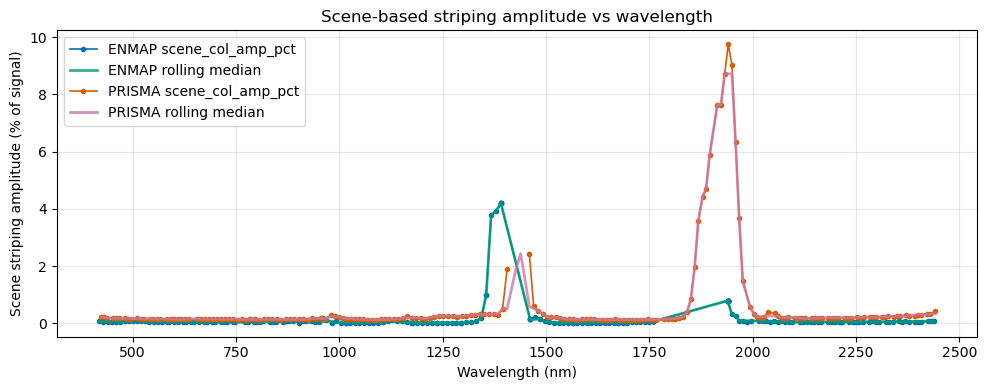

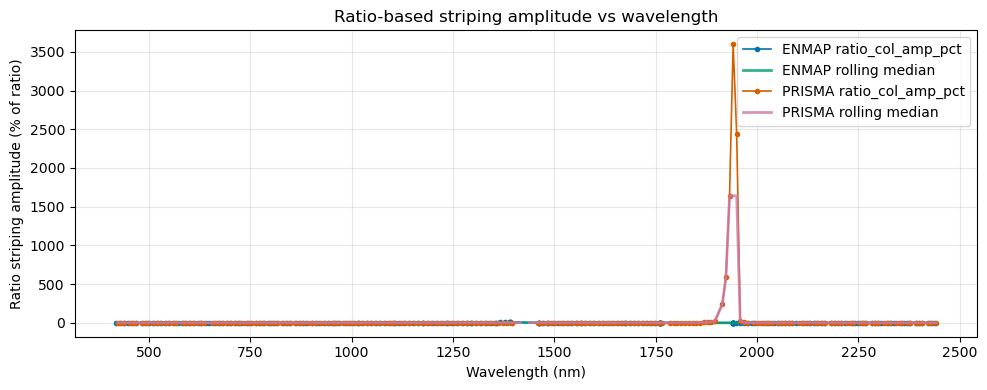

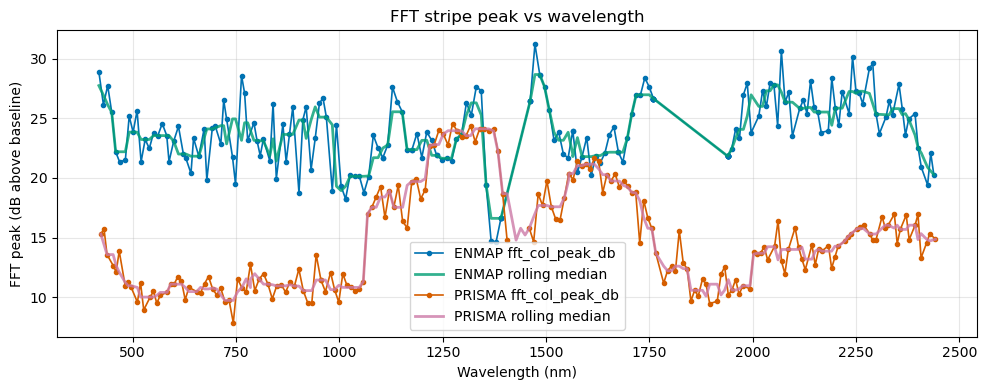

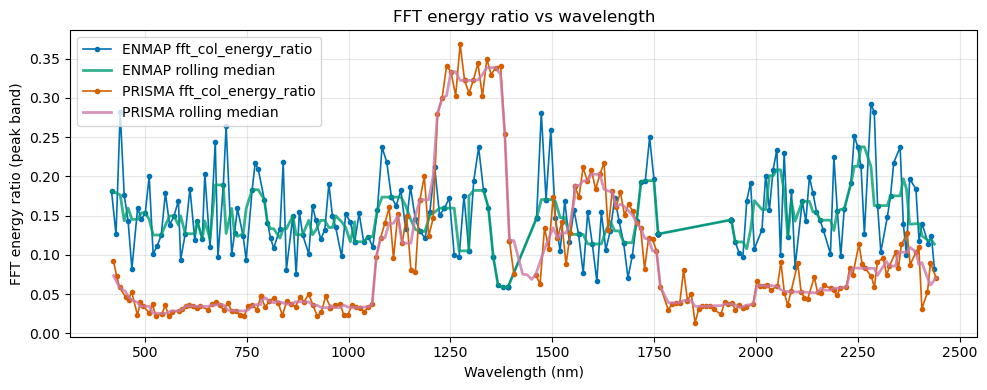

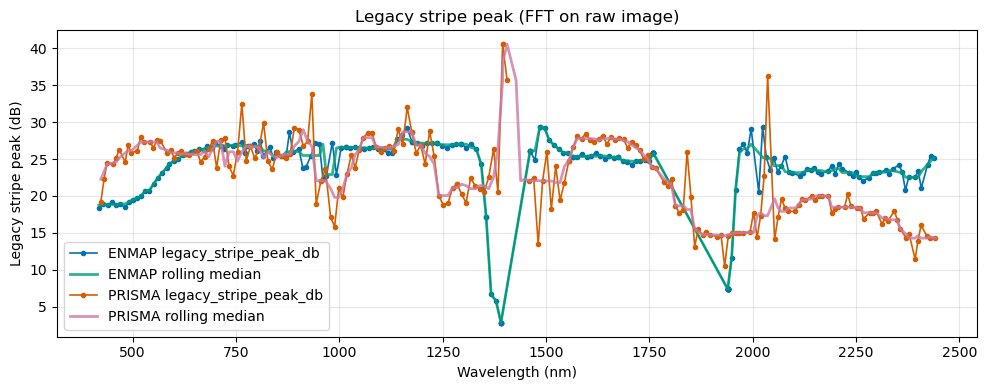

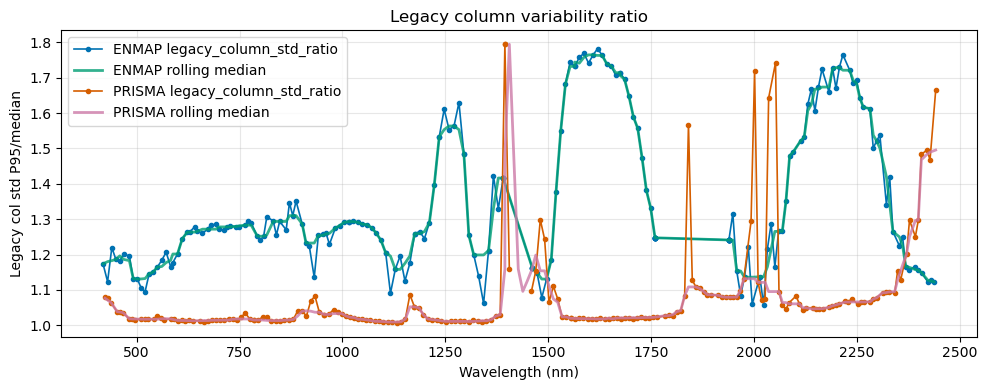

In [21]:
def plot_metric(df: pd.DataFrame, column: str, ylabel: str, title: str, rolling: int = 5, filename: str | None = None):
    fig, ax = plt.subplots(1, 1, figsize=(10, 4))
    for sensor, sub in df.groupby("sensor"):
        sub = sub.sort_values("band_nm")
        ax.plot(sub["band_nm"], sub[column], marker="o", ms=3, lw=1.2, label=f"{sensor} {column}")
        roll = sub[column].rolling(window=rolling, min_periods=1, center=True).median()
        ax.plot(sub["band_nm"], roll, lw=2.0, alpha=0.8, label=f"{sensor} rolling median")
    ax.set_xlabel("Wavelength (nm)")
    ax.set_ylabel(ylabel)
    ax.set_title(title)
    ax.grid(alpha=0.3)
    ax.legend()
    fig.tight_layout()
    if SAVE_FIGURES and filename:
        FIG_DIR.mkdir(parents=True, exist_ok=True)
        fig.savefig(FIG_DIR / filename, dpi=200)
    plt.show()

# Scene-based amplitude
plot_metric(
    striping_df,
    "scene_col_amp_pct",
    "Scene striping amplitude (% of signal)",
    "Scene-based striping amplitude vs wavelength",
    filename="fig_scene_amp_vs_wavelength.png",
)

# Ratio-based amplitude
plot_metric(
    striping_df,
    "ratio_col_amp_pct",
    "Ratio striping amplitude (% of ratio)",
    "Ratio-based striping amplitude vs wavelength",
    filename="fig_ratio_amp_vs_wavelength.png",
)

# FFT periodicity
plot_metric(
    striping_df,
    "fft_col_peak_db",
    "FFT peak (dB above baseline)",
    "FFT stripe peak vs wavelength",
    filename="fig_fft_peak_vs_wavelength.png",
)
plot_metric(
    striping_df,
    "fft_col_energy_ratio",
    "FFT energy ratio (peak band)",
    "FFT energy ratio vs wavelength",
    filename="fig_fft_energy_vs_wavelength.png",
)

# Legacy quick-look (optional)
plot_metric(
    striping_df,
    "legacy_stripe_peak_db",
    "Legacy stripe peak (dB)",
    "Legacy stripe peak (FFT on raw image)",
)
plot_metric(
    striping_df,
    "legacy_column_std_ratio",
    "Legacy col std P95/median",
    "Legacy column variability ratio",
)


## Methane absorption windows
Zoom the same metrics into CH4 windows (~1650, ~2300 nm).

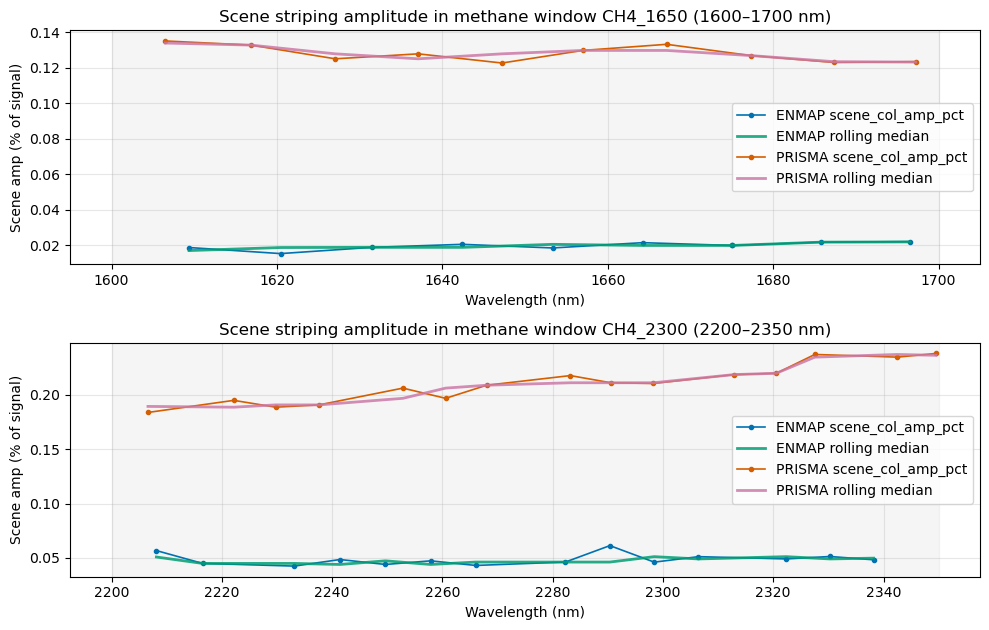

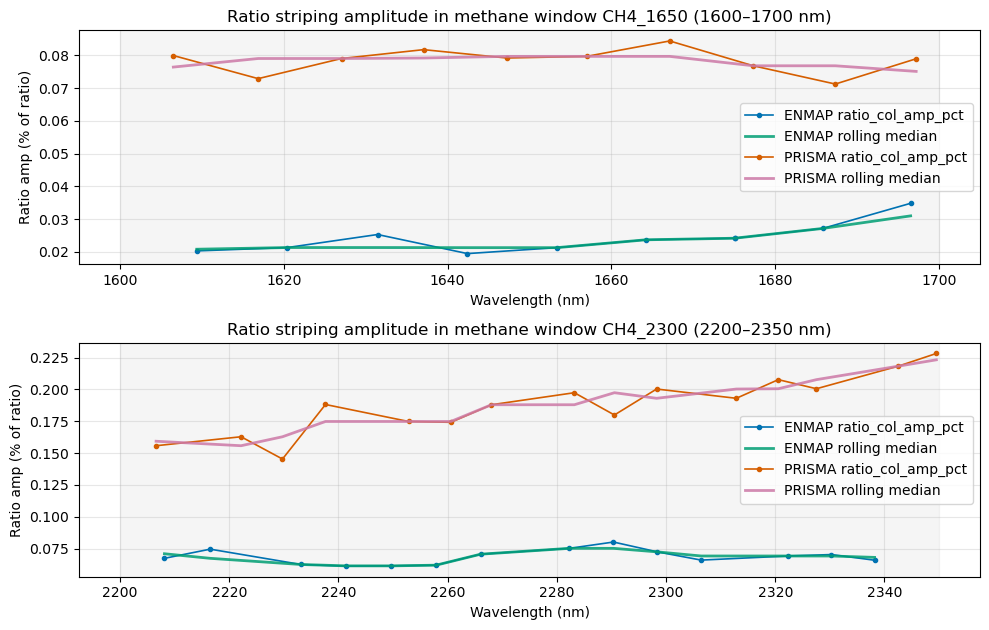

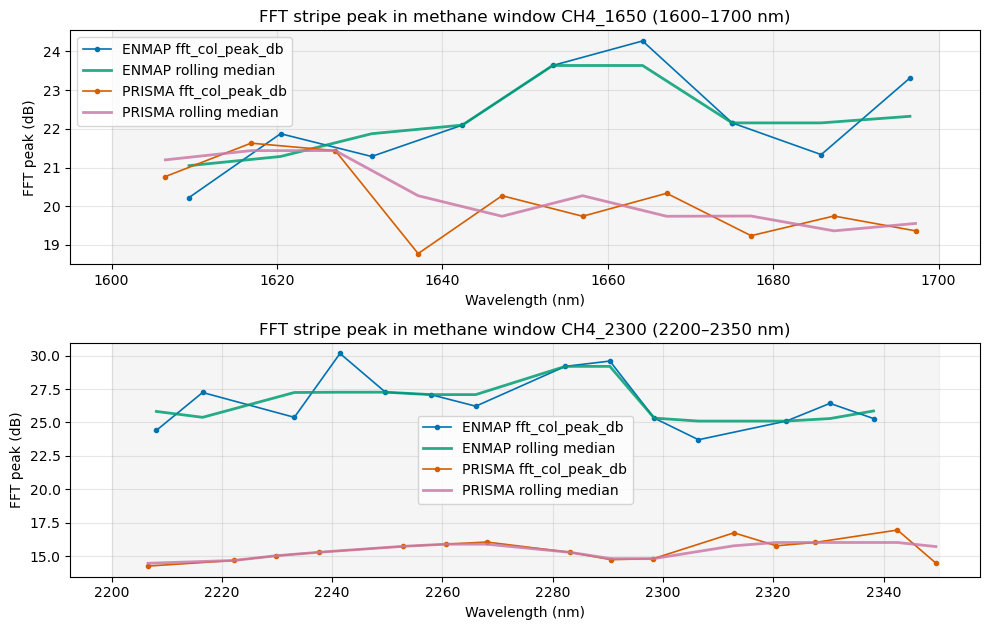

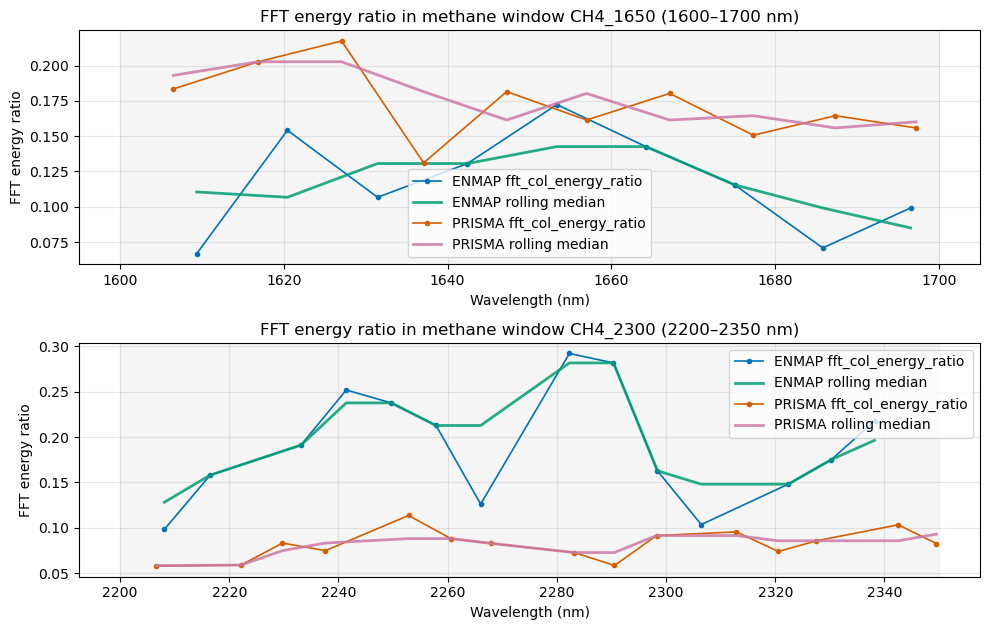

In [22]:
def plot_windows(df: pd.DataFrame, windows: dict, metric: str, ylabel: str, title_prefix: str, rolling: int = 3, filename_prefix: str | None = None):
    fig, axes = plt.subplots(len(windows), 1, figsize=(10, 3.2 * len(windows)), sharex=False)
    if len(windows) == 1:
        axes = [axes]
    for ax, (label, (lo, hi)) in zip(axes, windows.items()):
        sub = df[(df["band_nm"] >= lo) & (df["band_nm"] <= hi)]
        for sensor, grp in sub.groupby("sensor"):
            grp = grp.sort_values("band_nm")
            ax.plot(grp["band_nm"], grp[metric], marker="o", ms=3, lw=1.2, label=f"{sensor} {metric}")
            roll = grp[metric].rolling(window=rolling, min_periods=1, center=True).median()
            ax.plot(grp["band_nm"], roll, lw=2.0, alpha=0.85, label=f"{sensor} rolling median")
        ax.axvspan(lo, hi, color="gray", alpha=0.08)
        ax.set_title(f"{title_prefix} {label} ({lo:.0f}–{hi:.0f} nm)")
        ax.set_xlabel("Wavelength (nm)")
        ax.set_ylabel(ylabel)
        ax.grid(alpha=0.3)
        ax.legend()
    fig.tight_layout()
    if SAVE_FIGURES and filename_prefix:
        FIG_DIR.mkdir(parents=True, exist_ok=True)
        fig.savefig(FIG_DIR / f"{filename_prefix}_{metric}.png", dpi=200)
    plt.show()

plot_windows(striping_df, CH4_WINDOWS, "scene_col_amp_pct", "Scene amp (% of signal)", "Scene striping amplitude in methane window", filename_prefix="fig_window_scene_amp")
plot_windows(striping_df, CH4_WINDOWS, "ratio_col_amp_pct", "Ratio amp (% of ratio)", "Ratio striping amplitude in methane window", filename_prefix="fig_window_ratio_amp")
plot_windows(striping_df, CH4_WINDOWS, "fft_col_peak_db", "FFT peak (dB)", "FFT stripe peak in methane window", filename_prefix="fig_window_fft_peak")
plot_windows(striping_df, CH4_WINDOWS, "fft_col_energy_ratio", "FFT energy ratio", "FFT energy ratio in methane window", filename_prefix="fig_window_fft_energy")


## Worst-band column snapshots
Inspect the top bands by scene, ratio, and FFT metrics: raw and residual images, column-offset vector, and FFT power.

ENMAP: worst 2 by scene_col_amp_pct (scene amplitude)


,band_nm,scene_col_amp_pct,fft_col_peak_db,scene_col_amp_pct,ratio_col_amp_pct
98,1390.84,4.18907,16.613231,4.18907,5.344303
100,1390.84,4.18907,16.613231,4.18907,5.344303


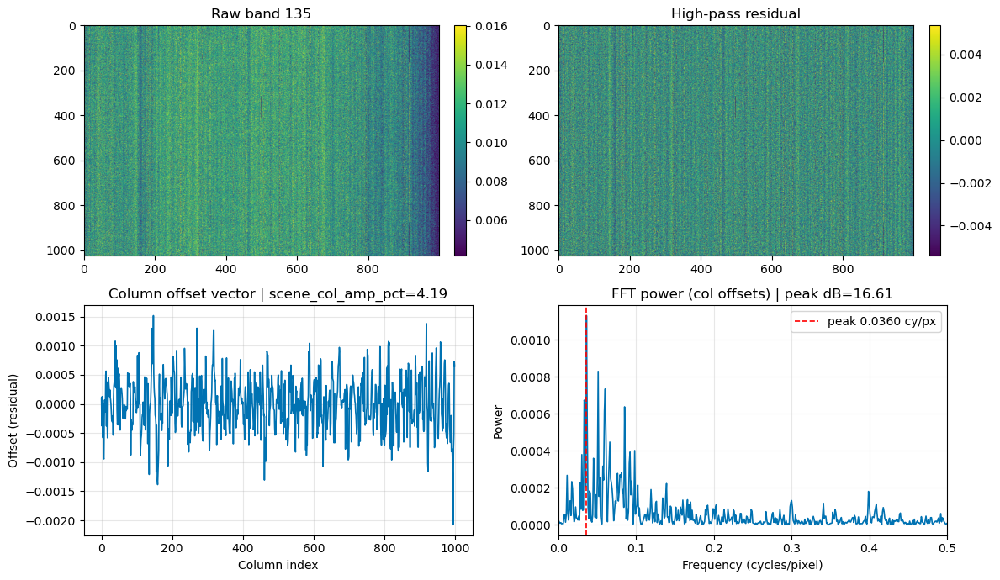

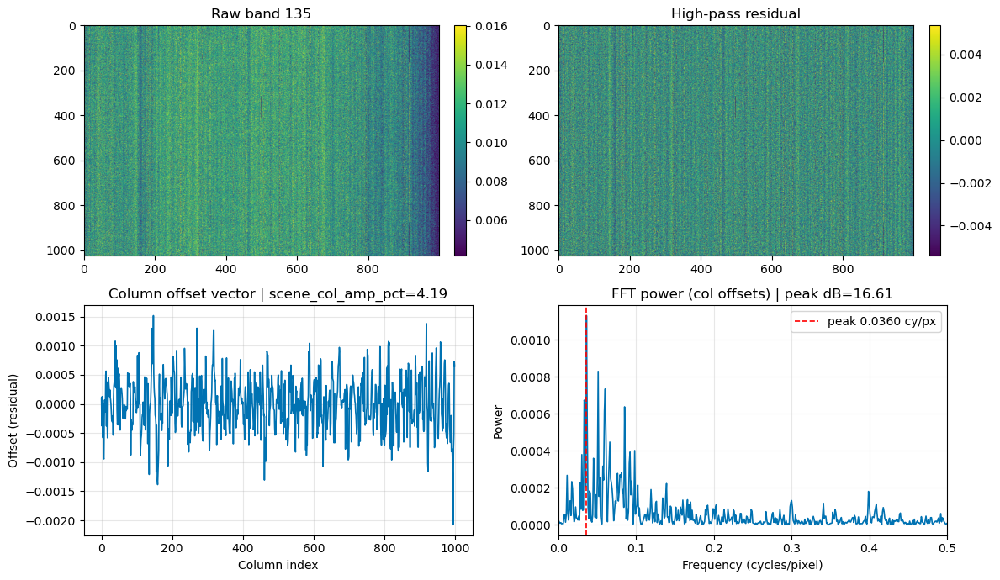

PRISMA: worst 2 by scene_col_amp_pct (scene amplitude)


,band_nm,scene_col_amp_pct,fft_col_peak_db,scene_col_amp_pct,ratio_col_amp_pct
355,1940.924820,9.749114,10.191522,9.749114,3597.536190
356,1949.715384,9.012618,10.601499,9.012618,2440.889985


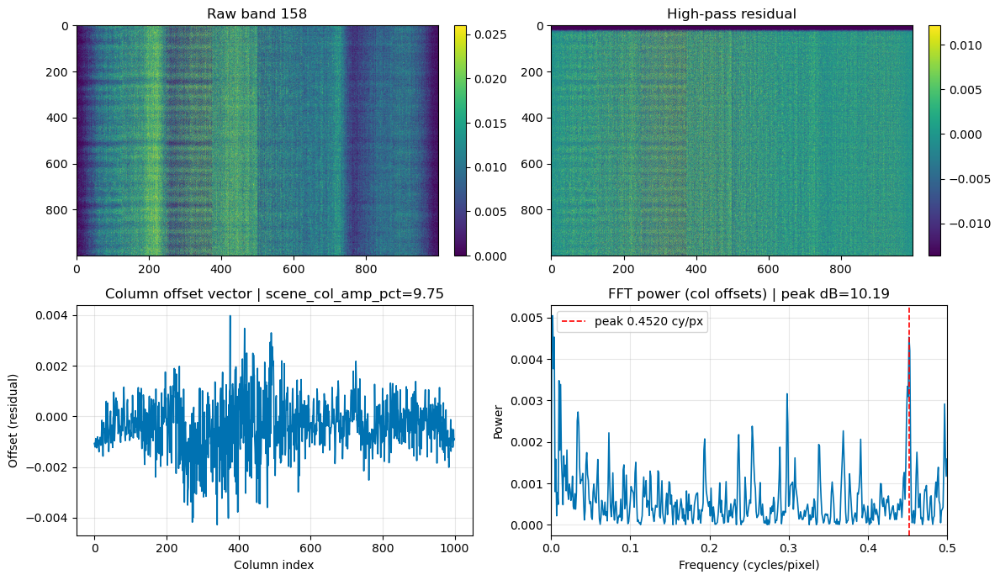

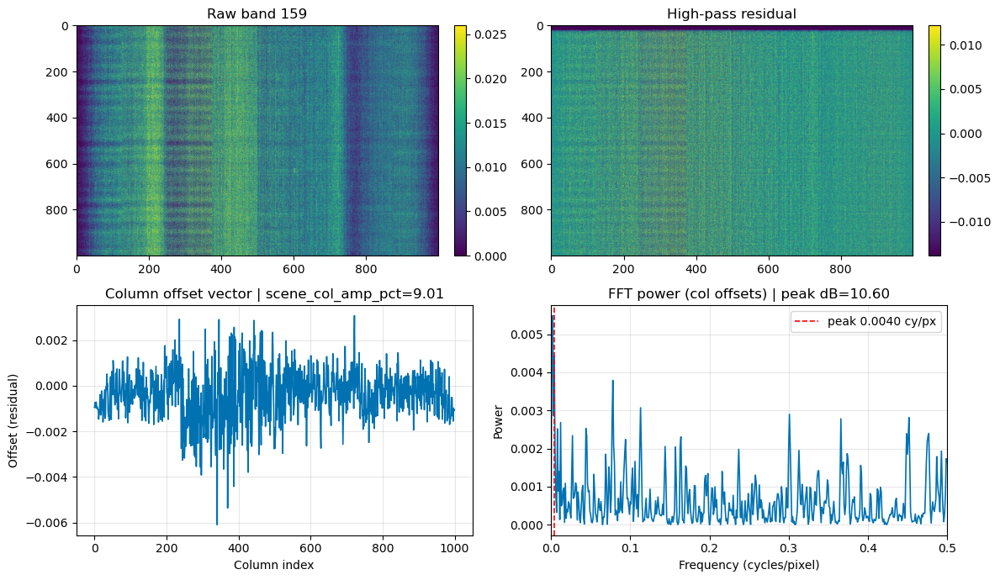

ENMAP: worst 2 by ratio_col_amp_pct (ratio amplitude)


,band_nm,ratio_col_amp_pct,fft_col_peak_db,scene_col_amp_pct,ratio_col_amp_pct
98,1390.84,5.344303,16.613231,4.18907,5.344303
100,1390.84,5.344303,16.613231,4.18907,5.344303


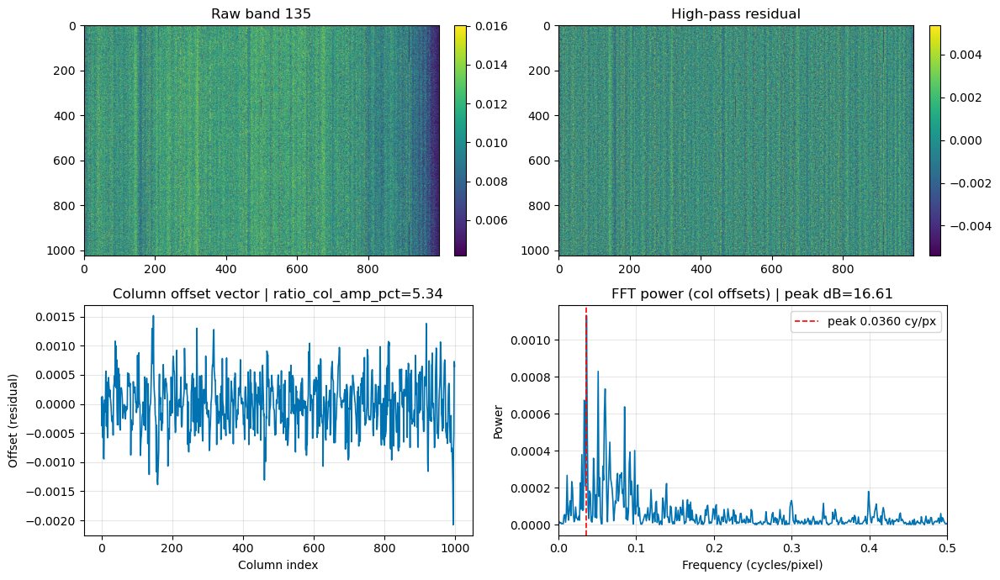

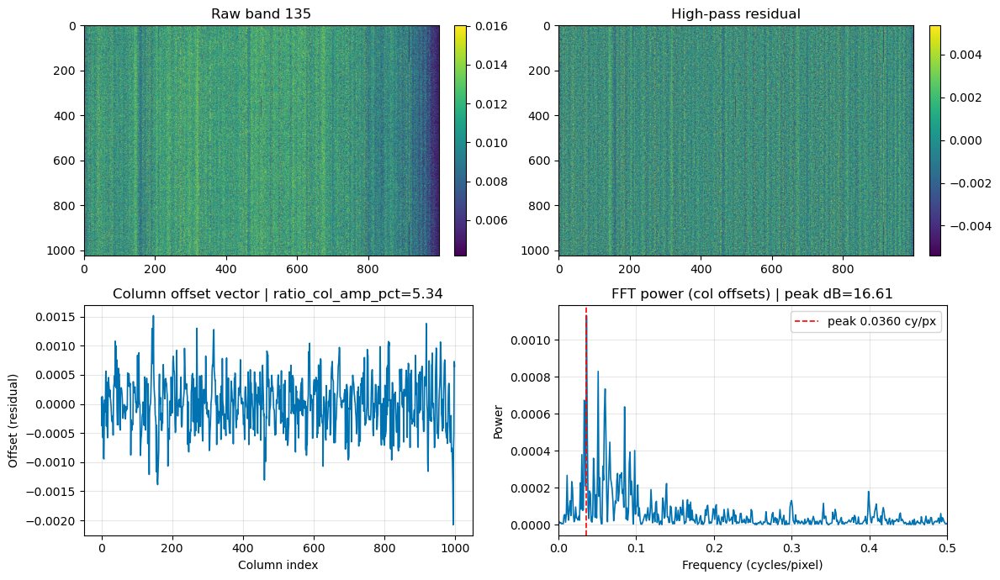

PRISMA: worst 2 by ratio_col_amp_pct (ratio amplitude)


,band_nm,ratio_col_amp_pct,fft_col_peak_db,scene_col_amp_pct,ratio_col_amp_pct
355,1940.924820,3597.536190,10.191522,9.749114,3597.536190
356,1949.715384,2440.889985,10.601499,9.012618,2440.889985


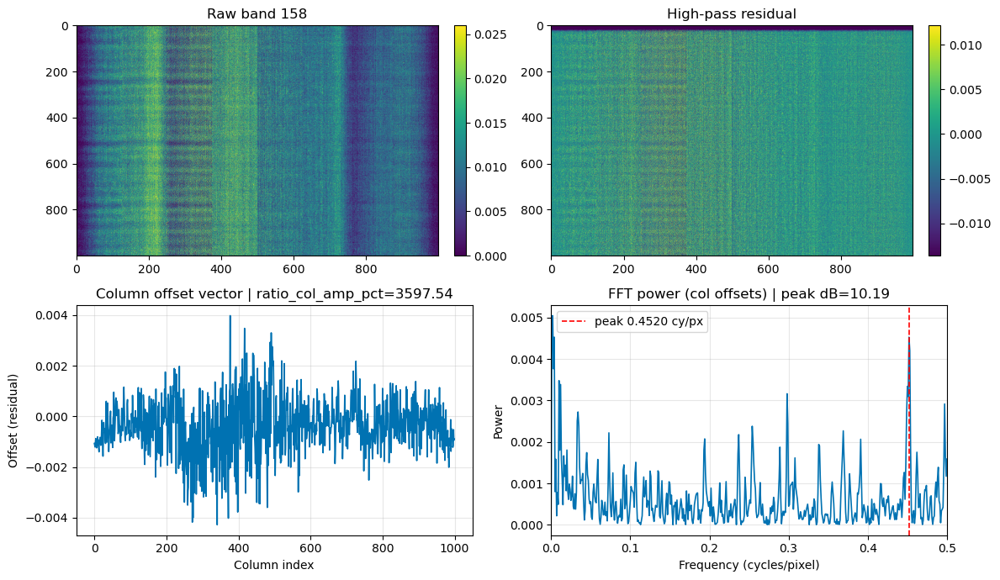

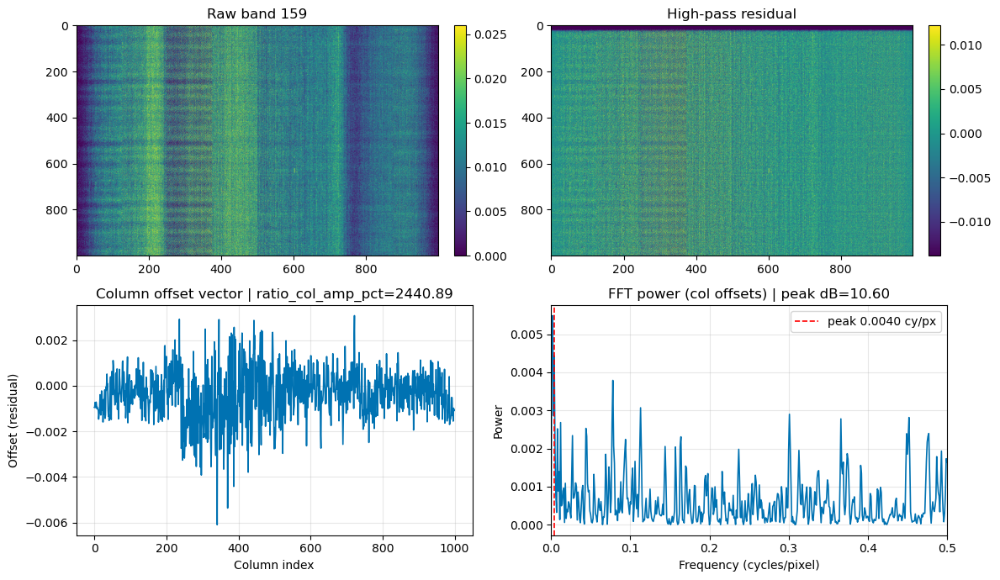

ENMAP: worst 2 by fft_col_energy_ratio (FFT energy)


,band_nm,fft_col_energy_ratio,fft_col_peak_db,scene_col_amp_pct,ratio_col_amp_pct
186,2282.290,0.292113,29.191145,0.046264,0.075154
2,439.504,0.281812,27.734953,0.050576,0.071136


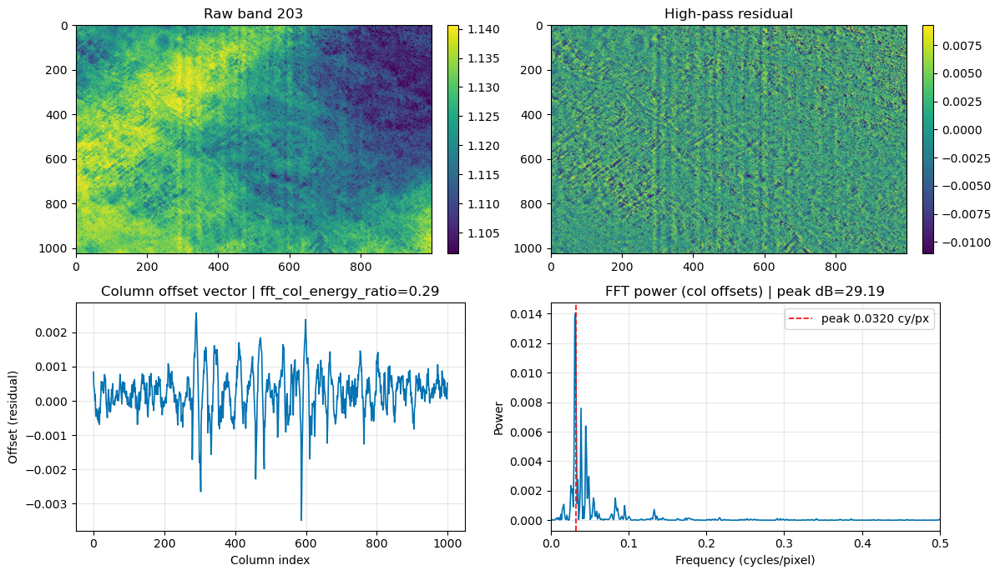

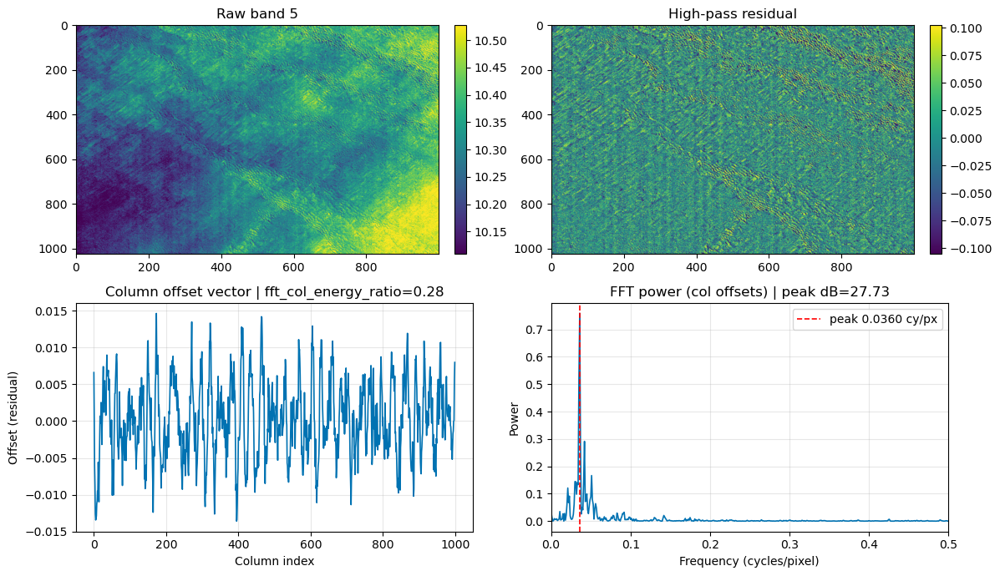

PRISMA: worst 2 by fft_col_energy_ratio (FFT energy)


,band_nm,fft_col_energy_ratio,fft_col_peak_db,scene_col_amp_pct,ratio_col_amp_pct
288,1273.812266,0.368422,24.543218,0.241163,0.110356
295,1339.399745,0.349564,24.117381,0.312784,0.198978


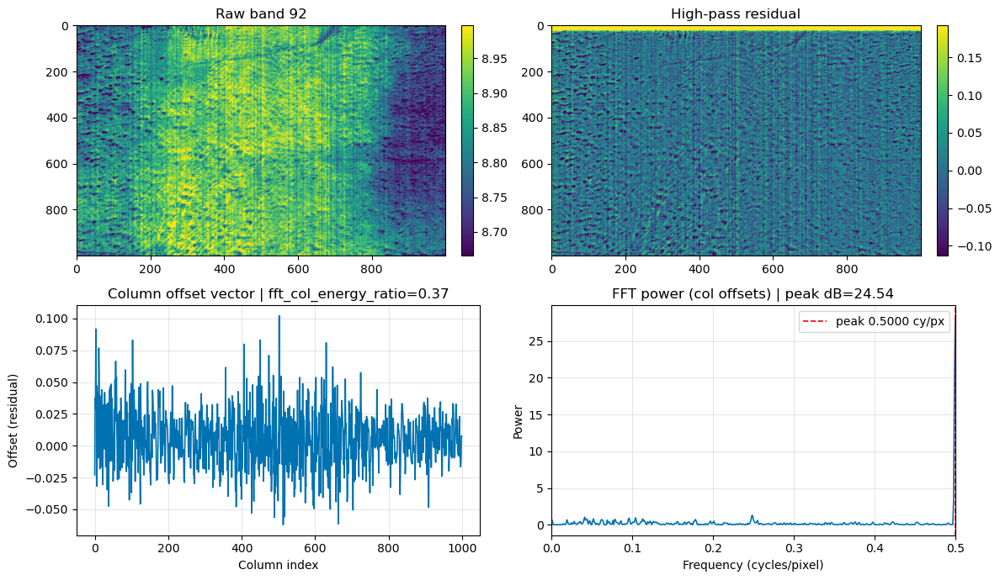

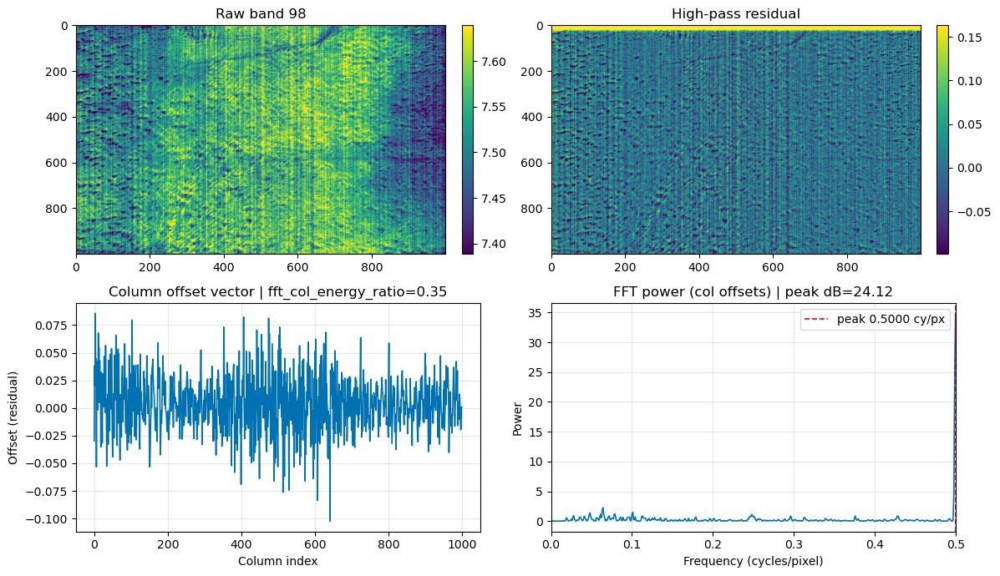

In [23]:
from IPython.display import display

def plot_band_diagnostics(img: np.ndarray, title: str, cmap: str = "viridis"):
    vmin, vmax = np.nanpercentile(img, [2, 98]) if np.isfinite(img).any() else (0, 1)
    plt.imshow(img, cmap=cmap, vmin=vmin, vmax=vmax)
    plt.colorbar(fraction=0.046, pad=0.04)
    plt.title(title)
    plt.axis('tight')

def inspect_band(scene: Dict[str, Any], band_idx: int, roi_spec: Optional[str], metric_label: str):
    img = scene["cube_brc"][band_idx].astype(float)
    img = apply_roi_and_crop(img, roi_spec, EDGE_CROP_COLS)
    resid = highpass(img)
    m_col = np.nanmedian(resid, axis=0)
    fft_col = fft_periodic_metrics(m_col, min_freq=MIN_FREQ_CYC_PER_PX, half_width_bins=PEAK_HALF_WIDTH_BINS)
    freqs = np.fft.rfftfreq(m_col.size, d=1.0)
    window = np.hanning(m_col.size)
    power = np.abs(np.fft.rfft((m_col - np.nanmedian(m_col)) * window)) ** 2

    fig, axes = plt.subplots(2, 2, figsize=(12, 7))
    plt.sca(axes[0, 0])
    plot_band_diagnostics(img, f"Raw band {band_idx+1}")
    plt.sca(axes[0, 1])
    plot_band_diagnostics(resid, f"High-pass residual")
    axes[1, 0].plot(m_col, lw=1.2)
    axes[1, 0].set_title(f"Column offset vector | {metric_label}")
    axes[1, 0].set_xlabel("Column index")
    axes[1, 0].set_ylabel("Offset (residual)")
    axes[1, 0].grid(alpha=0.3)
    axes[1, 1].plot(freqs, power, lw=1.2)
    peak_freq = fft_col.get("peak_freq")
    if peak_freq is not None and np.isfinite(peak_freq):
        axes[1, 1].axvline(peak_freq, color="r", lw=1.2, ls="--", label=f"peak {peak_freq:.4f} cy/px")
    axes[1, 1].set_xlim(0, freqs.max() if freqs.size else 1)
    axes[1, 1].set_title(f"FFT power (col offsets) | peak dB={fft_col.get('peak_db'):.2f}")
    axes[1, 1].set_xlabel("Frequency (cycles/pixel)")
    axes[1, 1].set_ylabel("Power")
    axes[1, 1].grid(alpha=0.3)
    axes[1, 1].legend()
    fig.tight_layout()
    plt.show()


def plot_worst_band(striping_df: pd.DataFrame, scenes: Dict[str, Dict[str, Any]], metric: str, n: int = 2, desc: str = ""):
    for sensor, sub in striping_df.groupby("sensor"):
        worst = sub.sort_values(metric, ascending=False).head(n)
        roi_spec = SCENE_CONFIG[sensor.lower()].get("striping_roi")
        print(f"{sensor}: worst {len(worst)} by {metric} {desc}")
        display(worst[["band_nm", metric, "fft_col_peak_db", "scene_col_amp_pct", "ratio_col_amp_pct"]])
        scene = scenes[sensor.lower()]
        for _, row in worst.iterrows():
            inspect_band(scene, int(row["band_index"]) - 1, roi_spec, metric_label=f"{metric}={row[metric]:.2f}")

plot_worst_band(striping_df, {"prisma": prisma_scene, "enmap": enmap_scene}, metric="scene_col_amp_pct", n=2, desc="(scene amplitude)")
plot_worst_band(striping_df, {"prisma": prisma_scene, "enmap": enmap_scene}, metric="ratio_col_amp_pct", n=2, desc="(ratio amplitude)")
plot_worst_band(striping_df, {"prisma": prisma_scene, "enmap": enmap_scene}, metric="fft_col_energy_ratio", n=2, desc="(FFT energy)")


## Worst 5 bands within methane windows
Top striping bands inside CH4 windows, using scene-based amplitude; plots reuse the diagnostic visuals.

CH4_1650: 1600-1700 nm
  ENMAP: worst 5 bands by scene_col_amp_pct


,band_nm,scene_col_amp_pct,fft_col_peak_db,fft_col_energy_ratio,ratio_col_amp_pct
128,1696.53,0.021991,23.314469,0.099153,0.034822
127,1685.80,0.021717,21.334054,0.070848,0.027138
124,1664.20,0.021417,24.271589,0.142632,0.023666
122,1642.41,0.020480,22.097040,0.130627,0.019451
126,1675.03,0.019842,22.154176,0.115541,0.024147


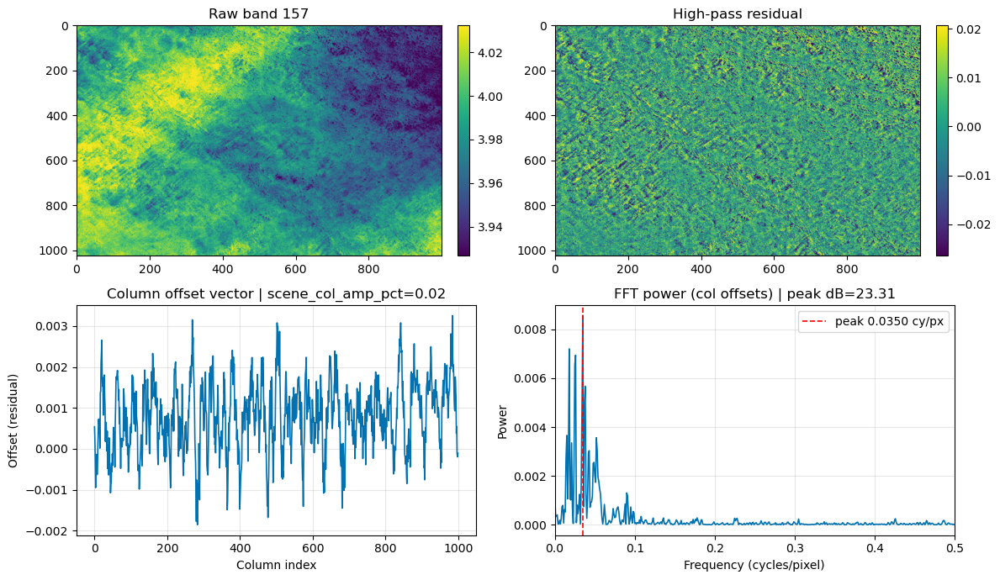

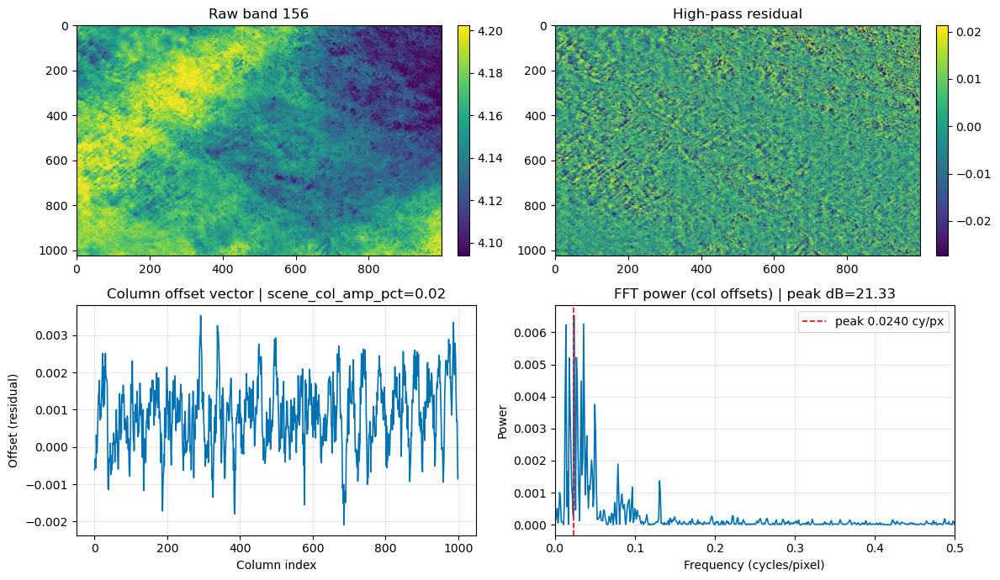

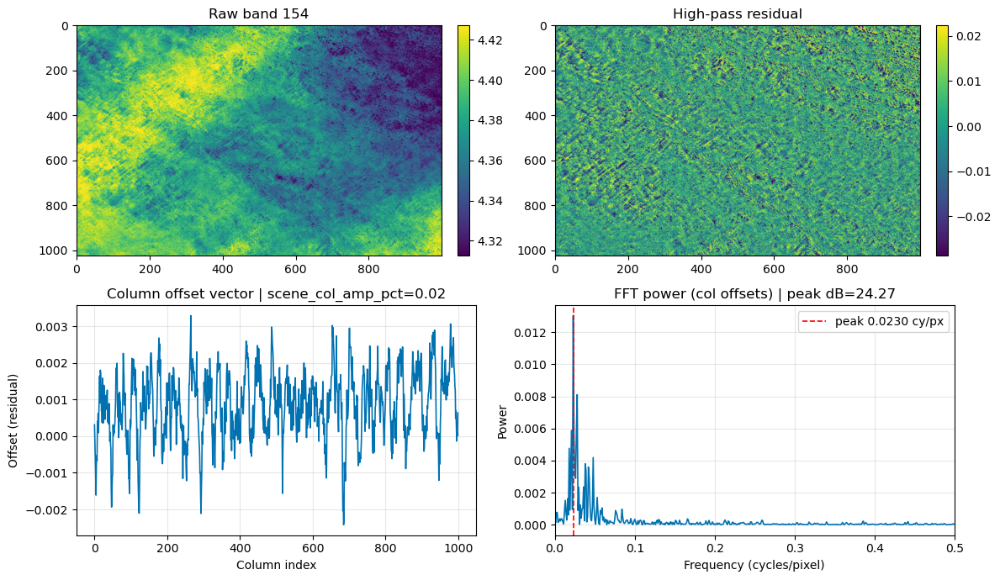

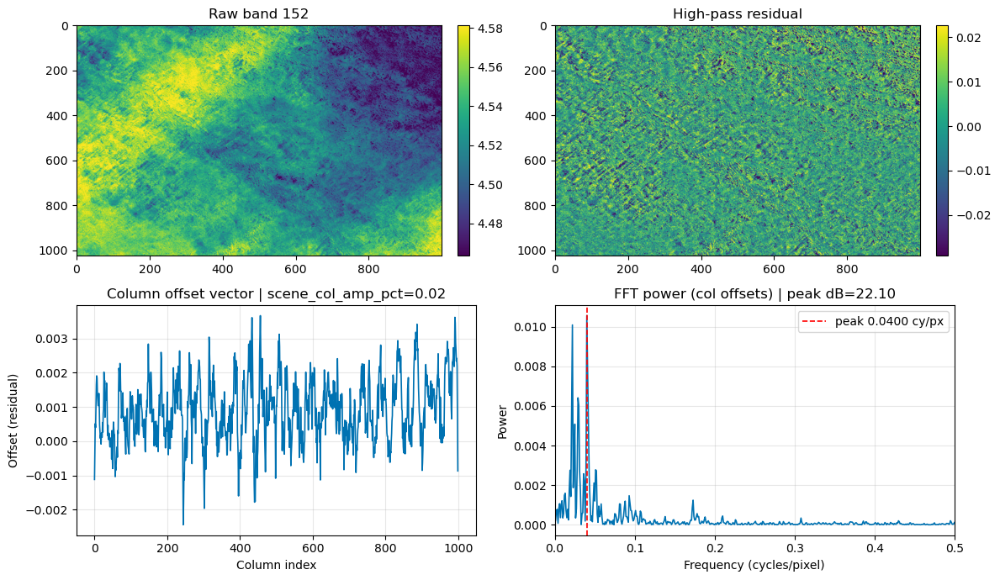

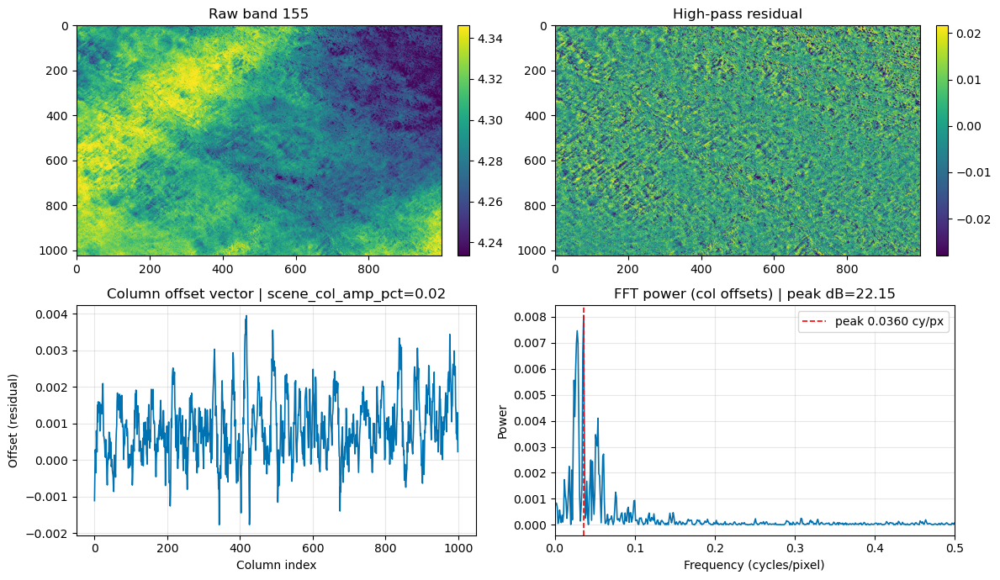

  PRISMA: worst 5 bands by scene_col_amp_pct


,band_nm,scene_col_amp_pct,fft_col_peak_db,fft_col_energy_ratio,ratio_col_amp_pct
322,1606.499244,0.135063,20.766999,0.183458,0.079985
328,1667.109568,0.133175,20.334639,0.180292,0.084439
323,1616.861924,0.132730,21.629961,0.202730,0.072926
327,1656.955084,0.129727,19.740489,0.161456,0.079728
325,1637.061402,0.127811,18.775728,0.131098,0.081786


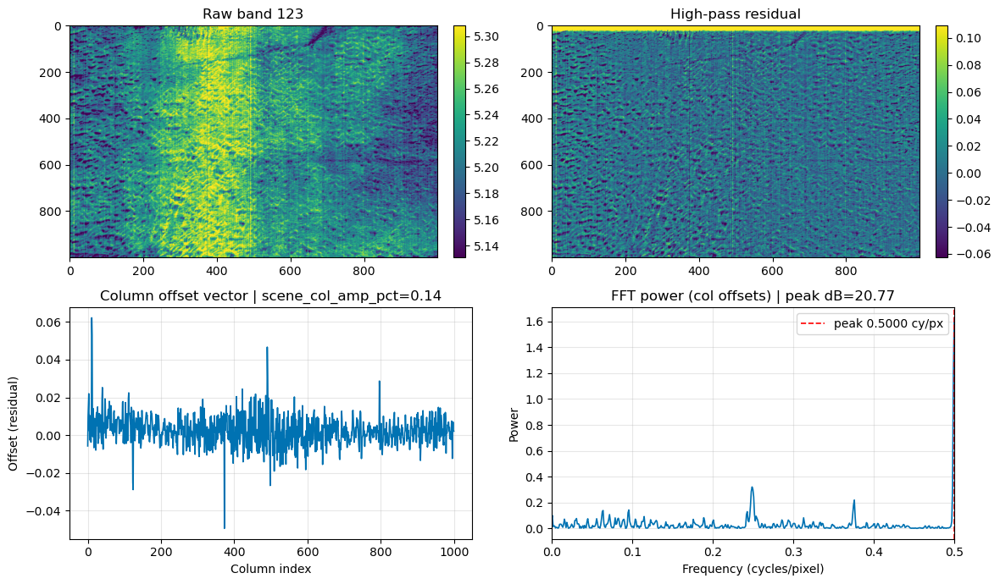

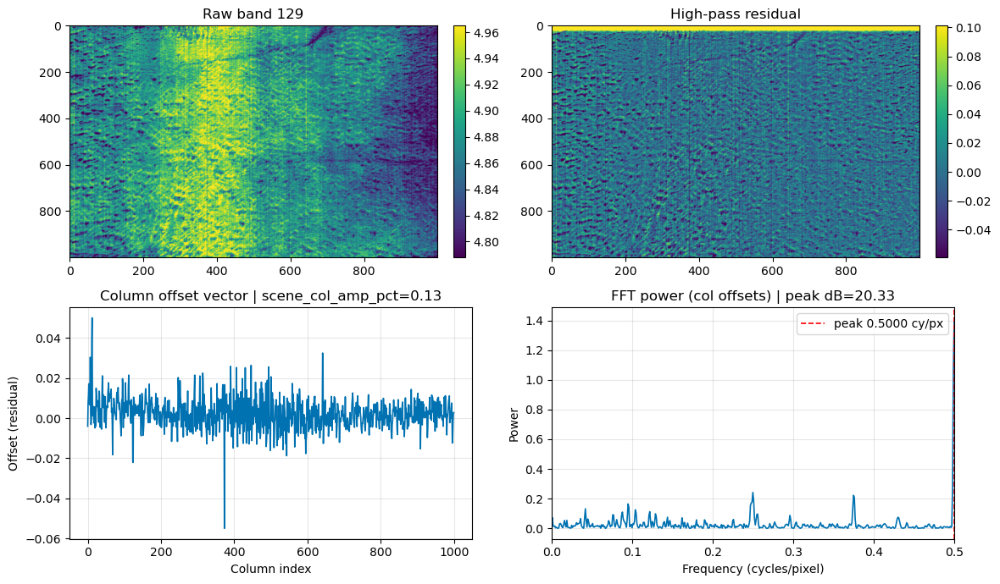

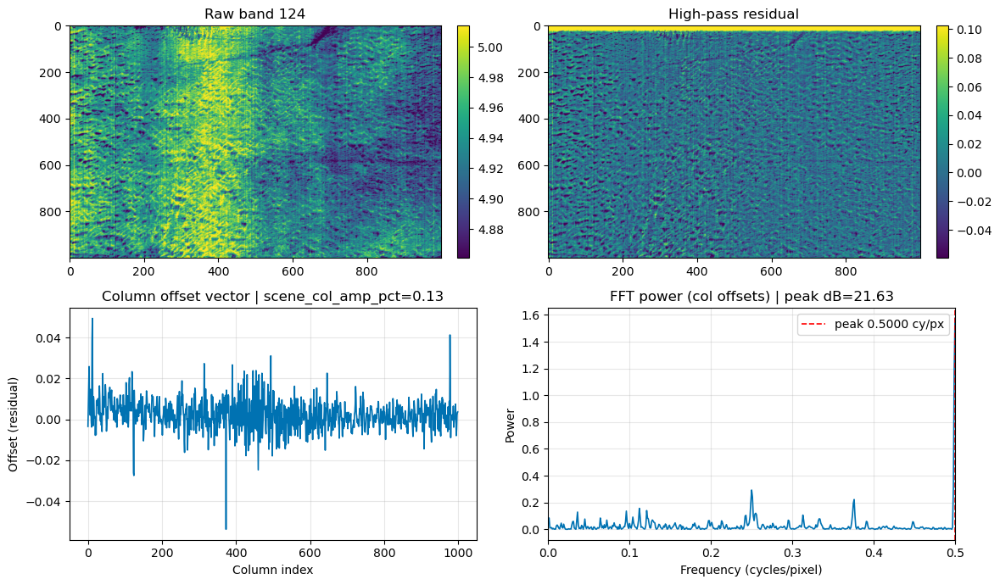

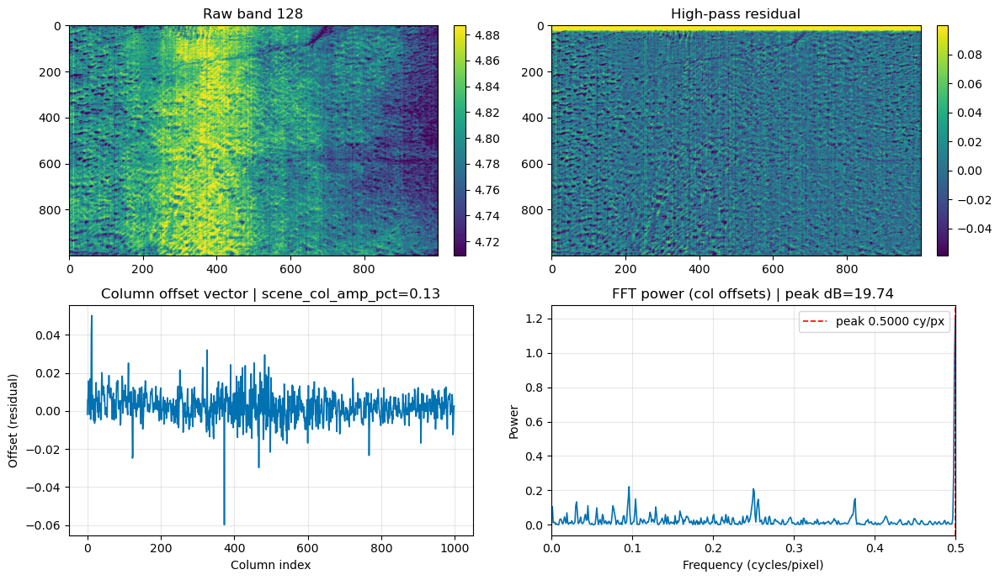

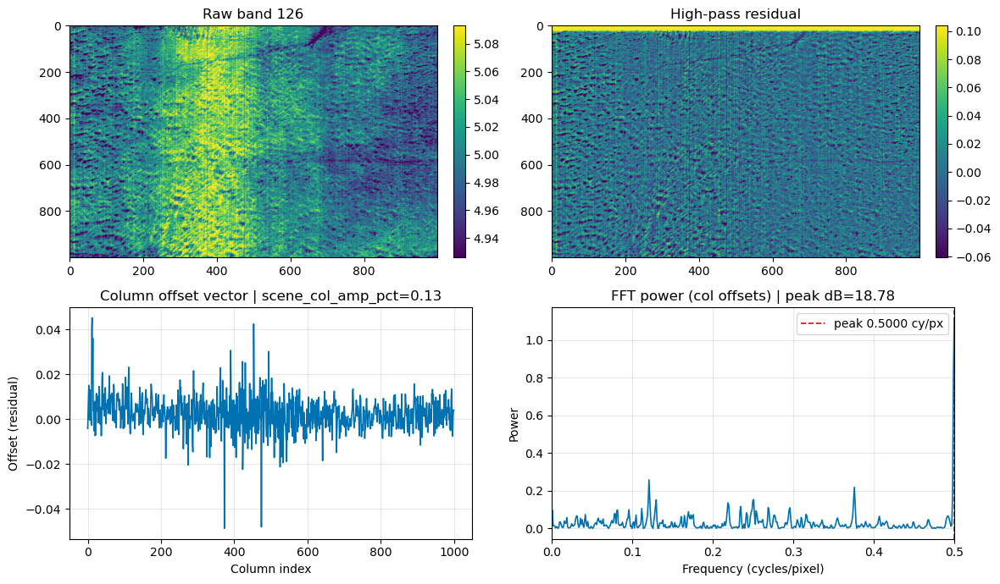

CH4_2300: 2200-2350 nm
  ENMAP: worst 5 bands by scene_col_amp_pct


,band_nm,scene_col_amp_pct,fft_col_peak_db,fft_col_energy_ratio,ratio_col_amp_pct
187,2290.37,0.061348,29.587326,0.281704,0.080105
179,2208.12,0.056790,24.411687,0.098380,0.067304
191,2330.29,0.051379,26.428844,0.175244,0.070271
189,2306.44,0.051221,23.713012,0.103596,0.065908
190,2322.37,0.049120,25.106402,0.148092,0.069139


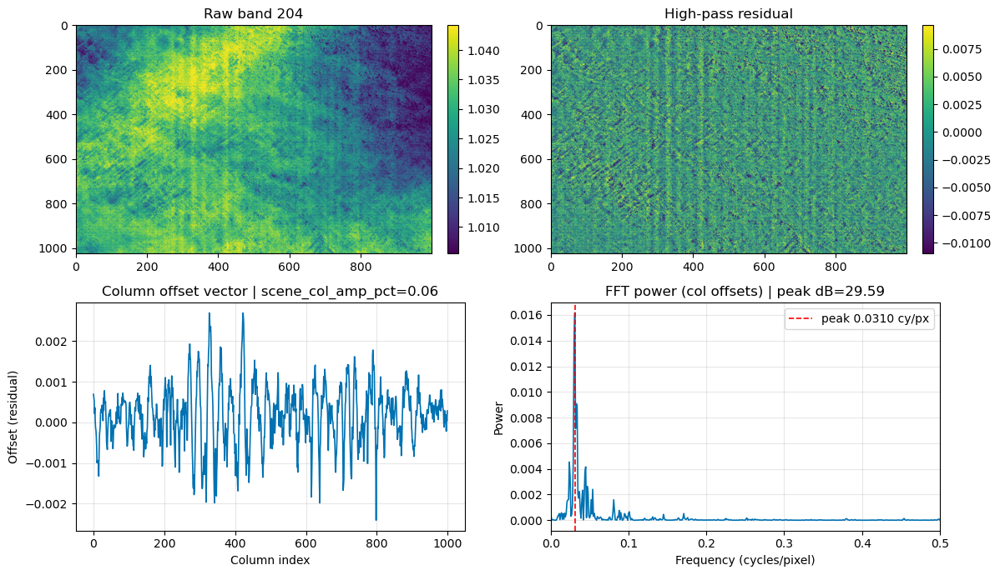

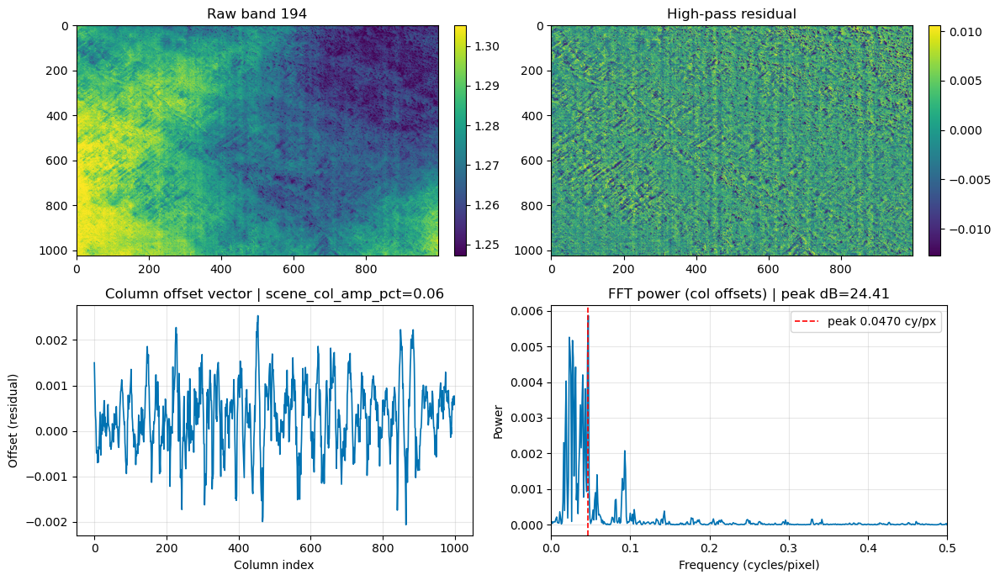

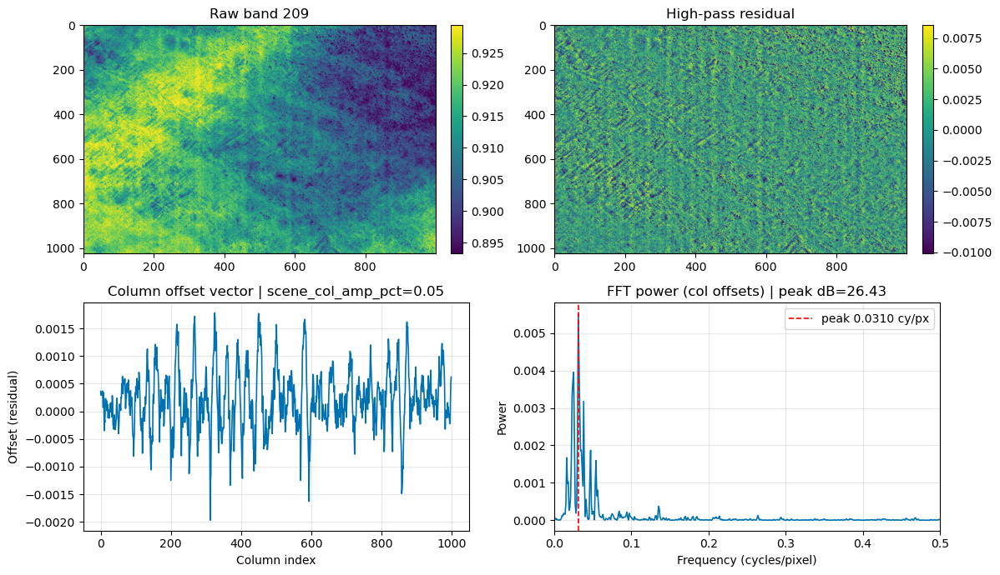

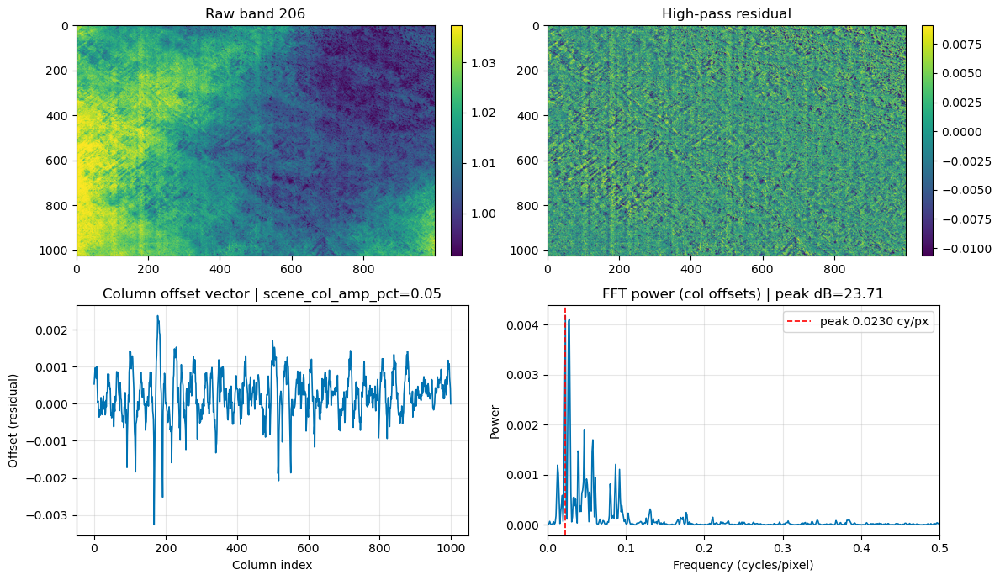

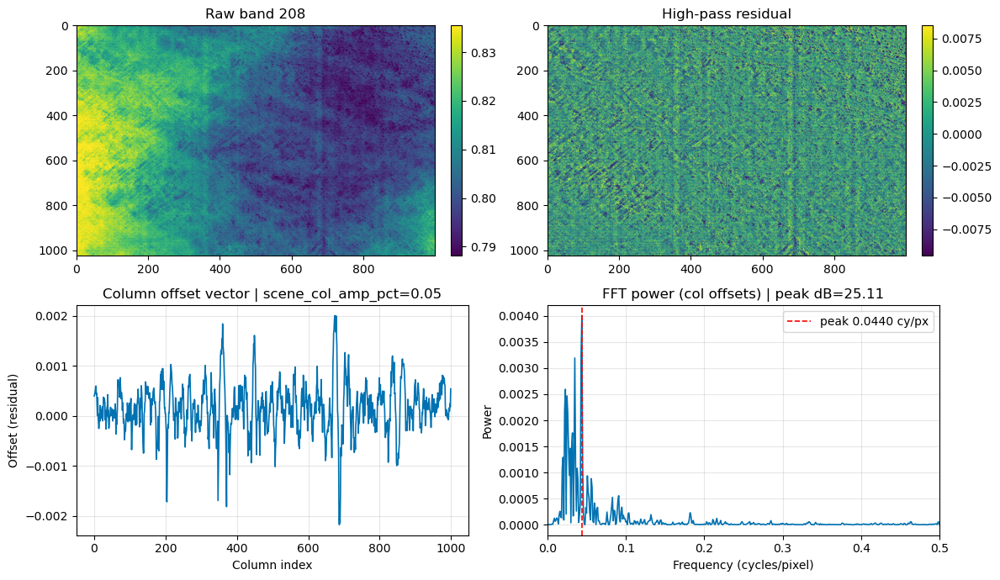

  PRISMA: worst 5 bands by scene_col_amp_pct


,band_nm,scene_col_amp_pct,fft_col_peak_db,fft_col_energy_ratio,ratio_col_amp_pct
396,2349.505343,0.237739,14.497004,0.082709,0.228258
394,2327.540670,0.236830,16.039360,0.085726,0.200549
395,2342.528547,0.234369,16.970128,0.103345,0.218277
393,2320.560106,0.219570,15.794274,0.073957,0.207683
392,2312.865734,0.218333,16.761124,0.095553,0.193035


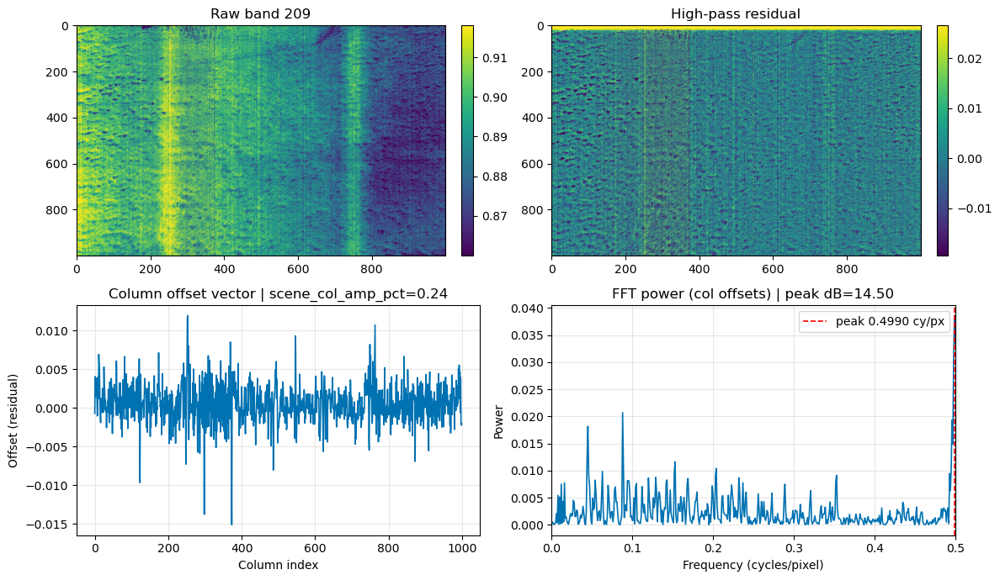

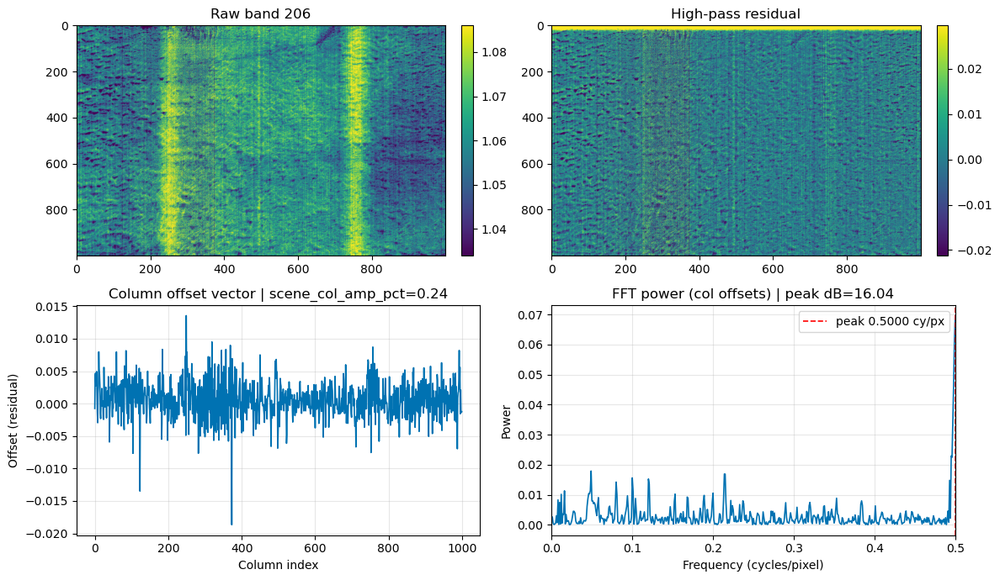

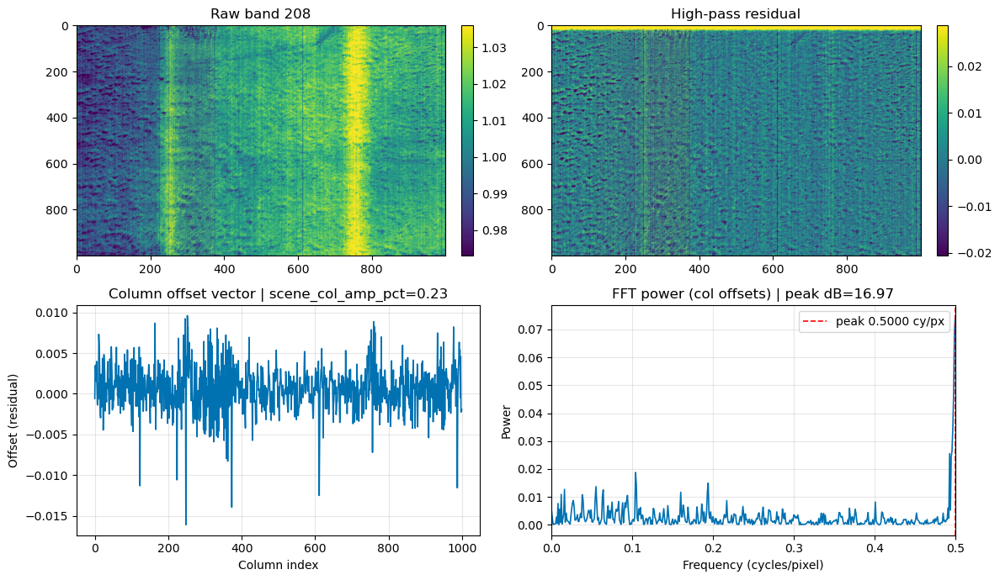

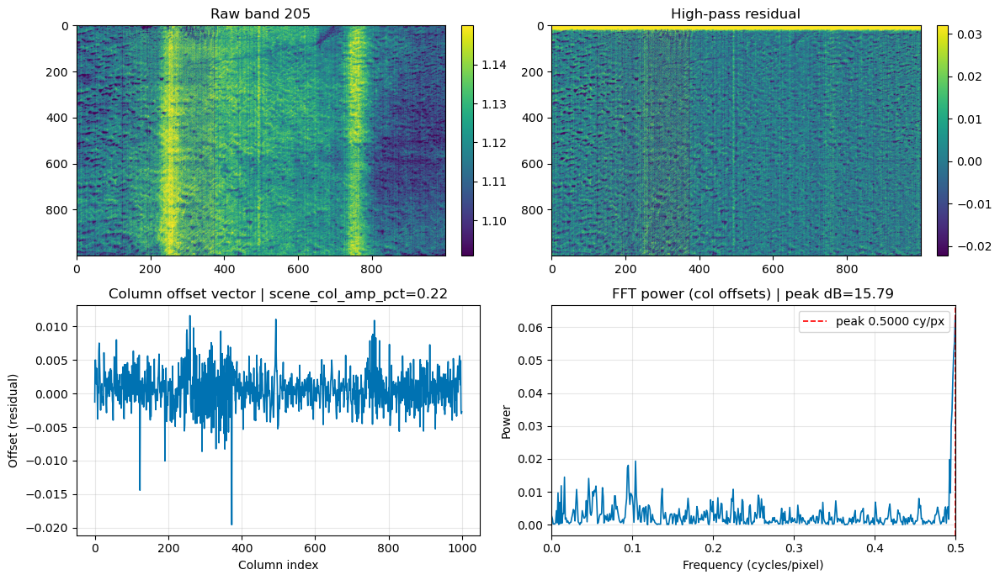

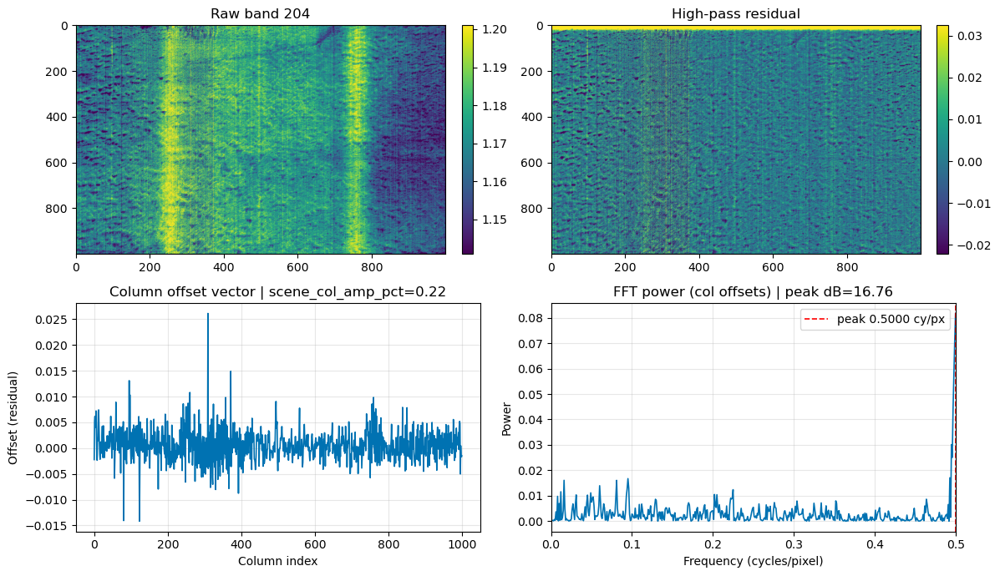

In [25]:
from IPython.display import display

def plot_worst_bands_in_windows(striping_df: pd.DataFrame, scenes: Dict[str, Dict[str, Any]], windows: dict, metric: str = "scene_col_amp_pct", n: int = 5):
    for label, (lo, hi) in windows.items():
        print(f"{label}: {lo:.0f}-{hi:.0f} nm")
        sub = striping_df[(striping_df["band_nm"] >= lo) & (striping_df["band_nm"] <= hi)]
        if sub.empty:
            print("  No bands in window.")
            continue
        for sensor, grp in sub.groupby("sensor"):
            if metric not in grp.columns:
                print(f"  {sensor}: metric {metric} missing")
                continue
            worst = grp.dropna(subset=[metric]).sort_values(metric, ascending=False).head(n)
            roi_spec = SCENE_CONFIG[sensor.lower()].get("striping_roi")
            scene = scenes[sensor.lower()]
            print(f"  {sensor}: worst {len(worst)} bands by {metric}")
            display(worst[["band_nm", metric, "fft_col_peak_db", "fft_col_energy_ratio", "ratio_col_amp_pct"]])
            for _, row in worst.iterrows():
                inspect_band(scene, int(row["band_index"]) - 1, roi_spec, metric_label=f"{metric}={row[metric]:.2f}")

# reuse scene-based metric by default
plot_worst_bands_in_windows(striping_df, {"prisma": prisma_scene, "enmap": enmap_scene}, CH4_WINDOWS, metric="scene_col_amp_pct", n=5)


## Export results
Save per-band metrics, summaries, and worst-band listings for citation and reuse.

In [26]:
from datetime import datetime

TABLE_DIR.mkdir(parents=True, exist_ok=True)
out_prefix = datetime.utcnow().strftime('%Y%m%dT%H%M%SZ')

full_csv = TABLE_DIR / f"striping_metrics_{out_prefix}.csv"
striping_df.to_csv(full_csv, index=False)
print(f"Saved per-band metrics to {full_csv}")

summary_overall_path = TABLE_DIR / f"summary_overall_{out_prefix}.csv"
summary_by_window_path = TABLE_DIR / f"summary_by_window_{out_prefix}.csv"
qc_overall_path = TABLE_DIR / f"qc_overall_{out_prefix}.csv"
qc_by_window_path = TABLE_DIR / f"qc_by_window_{out_prefix}.csv"

summary_overall.to_csv(summary_overall_path, index=False)
summary_by_window.to_csv(summary_by_window_path, index=False)
qc_overall.to_csv(qc_overall_path, index=False)
qc_by_window.to_csv(qc_by_window_path, index=False)
print(f"Saved summaries to {summary_overall_path} and {summary_by_window_path}")

worst_by_window = worst_bands_by_window(striping_df_windows, ["scene_col_amp_pct", "ratio_col_amp_pct", "fft_col_peak_db", "fft_col_energy_ratio"], n=5)
worst_by_window_path = TABLE_DIR / f"worst_bands_by_window_{out_prefix}.csv"
worst_by_window.to_csv(worst_by_window_path, index=False)
print(f"Saved worst-band table to {worst_by_window_path}")

md_path = TABLE_DIR / f"summary_by_window_{out_prefix}.md"
try:
    with open(md_path, "w") as f:
        f.write(summary_by_window.to_markdown(index=False))
    print(f"Saved markdown summary to {md_path}")
except Exception as exc:
    print(f"Markdown export skipped: {exc}")


Saved per-band metrics to /mnt/d/Lavoro/Assegno_Ricerca_Sapienza/CLEAR_UP/CH4_detection/Matched_filter_approach/hygas/notebooks/outputs/striping_metrics_20251221T162605Z.csv
Saved summaries to /mnt/d/Lavoro/Assegno_Ricerca_Sapienza/CLEAR_UP/CH4_detection/Matched_filter_approach/hygas/notebooks/outputs/summary_overall_20251221T162605Z.csv and /mnt/d/Lavoro/Assegno_Ricerca_Sapienza/CLEAR_UP/CH4_detection/Matched_filter_approach/hygas/notebooks/outputs/summary_by_window_20251221T162605Z.csv
Saved worst-band table to /mnt/d/Lavoro/Assegno_Ricerca_Sapienza/CLEAR_UP/CH4_detection/Matched_filter_approach/hygas/notebooks/outputs/worst_bands_by_window_20251221T162605Z.csv
Markdown export skipped: Missing optional dependency 'tabulate'.  Use pip or conda to install tabulate.


Notes
- `STRIPE_TARGET_MODE="grid"` with `GRID_STEP_NM=10` sweeps densely; switch to `"manual"` to match anchor wavelengths.
- `MAX_RATIO_DWL_NM` guards ratio metrics; large band gaps yield NaN ratios. Row metrics can be toggled via `COMPUTE_ROW_METRICS`.
- Use `EDGE_CROP_COLS` or `striping_roi` to isolate clean detector regions if needed.
- Low-signal bands and low valid fractions are masked to NaN to avoid spurious peaks.
- Export cell saves `striping_df` for downstream comparison/reporting.
